In [1]:
import anndata as ad
import copy
import loompy
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy.api as sc
import warnings
warnings.filterwarnings('ignore')

### Initial setup

In [2]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.set_figure_params(dpi=150,
                     dpi_save=300,
                     vector_friendly=False,
                     transparent=True,
                     format="pdf")
sc.logging.print_versions()

# Output-specific variables
directory = "../output_and_analysis/reanalysis/"
data_stem = directory + "K562-HCT-HyPB"
data_file = data_stem + ".h5ad"
data = sc.read(data_file)

k_stem = directory + "K562-HyPB"
k_file = k_stem + ".h5ad"
raw_k_file = k_stem + "_raw.h5ad"
umap_k_file = k_stem + "_umap.h5ad"

h_stem = directory + "HCT-116-HyPB"
h_file = h_stem + ".h5ad"
raw_h_file = h_stem + "_raw.h5ad"
umap_h_file = h_stem + "_umap.h5ad"

scanpy==1.3.7 anndata==0.6.17 numpy==1.17.2 scipy==1.2.1 pandas==0.23.4 scikit-learn==0.21.3 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1 


In [3]:
sc.logging.print_memory_usage()

Memory usage: current 2.50 GB, difference +2.50 GB


In [4]:
# Helper function to process batches
def preprocess_batch(path, barcode_file = None):
    adata = sc.read(path + "matrix.mtx", cache = True).T
    adata.var_names = pd.read_csv(path + 'genes.tsv', header=None, sep='\t')[1]
    adata.obs_names = pd.read_csv(path + 'barcodes.tsv', header=None)[0]
    adata.var_names_make_unique()
    if barcode_file:
        barcodes = [line.strip() for line in open(barcode_file, 'r')]
        adata = adata[barcodes, :]
    return adata

In [5]:
# Helper function to write all important data to Loom file
# This attempts to adhere to the Loom 2.0 conventions described here:
# http://linnarssonlab.org/loompy/conventions/index.html
def scanpyToLoom(adata, loomFilename, sampleName):
    assert loomFilename.endswith(".loom")
    # Write loom file to disk first
    adata.write_loom(loomFilename)
    # Connect to loom file and add data
    with loompy.connect(loomFilename) as l:
        # Set title (yes this references a global variable and is bad form)
        l.attrs["title"] = sampleName
        # Set gene names
        l.row_attrs["Gene"] = adata.var_names.to_native_types()
        # Set cell barcodes
        l.col_attrs["CellID"] = adata.obs_names.to_native_types()
        # Add embedding coordinates
        if "X_pca" in adata.obsm.keys():
            l.col_attrs["_PC1"] = adata.obsm["X_pca"][:, 0]
            l.col_attrs["_PC2"] = adata.obsm["X_pca"][:, 1]
        if "X_tsne" in adata.obsm.keys():
            l.col_attrs["_tSNE1"] = adata.obsm["X_tsne"][:, 0]
            l.col_attrs["_tSNE2"] = adata.obsm["X_tsne"][:, 1]
        if "X_umap" in adata.obsm.keys():
            l.col_attrs["_UMAP1"] = adata.obsm["X_umap"][:, 0]
            l.col_attrs["_UMAP2"] = adata.obsm["X_umap"][:, 1]
    print("Wrote {}".format(loomFilename))

In [6]:
%%time
# Load the libraries
batch_paths = ["K562-HCT-WTHYPB-SRT_map_cDNA_hg38/outs/filtered_gene_bc_matrices/hg38/",
               "K562-HCT-WTHYPB-SRT1_map_cDNA_hg38/outs/filtered_gene_bc_matrices/hg38/",
               "K562-HCT-WTHYPB-SRT2_map_cDNA_hg38/outs/filtered_gene_bc_matrices/hg38/",
               "K562-HCT-WTHYPB-SRT3_map_cDNA_hg38/outs/filtered_gene_bc_matrices/hg38/",]
barcode_files = ["K562-HCT-HyPB-0_uniqBarcodes.txt",
                 "K562-HCT-HyPB-1_uniqBarcodes.txt",
                 "K562-HCT-HyPB-2_uniqBarcodes.txt",
                 "K562-HCT-HyPB-3_uniqBarcodes.txt"]
batch_names = ["0", "1", "2", "3"]
batches = [preprocess_batch(path, barcode_file = barcodes) for path, barcodes in zip(batch_paths, barcode_files)]

... reading from cache file ./cache/K562-HCT-WTHYPB-SRT_map_cDNA_hg38-outs-filtered_gene_bc_matrices-hg38-matrix.h5ad


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... reading from cache file ./cache/K562-HCT-WTHYPB-SRT1_map_cDNA_hg38-outs-filtered_gene_bc_matrices-hg38-matrix.h5ad


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... reading from cache file ./cache/K562-HCT-WTHYPB-SRT2_map_cDNA_hg38-outs-filtered_gene_bc_matrices-hg38-matrix.h5ad


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... reading from cache file ./cache/K562-HCT-WTHYPB-SRT3_map_cDNA_hg38-outs-filtered_gene_bc_matrices-hg38-matrix.h5ad


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


CPU times: user 13.7 s, sys: 1.61 s, total: 15.3 s
Wall time: 6.44 s


In [7]:
# Concatenate batches
raw_adata = ad.AnnData.concatenate(*batches, batch_categories = batch_names, index_unique = None)
# We can specify index_unique = None because we have prefiltered with barcode_files

In [8]:
raw_adata.obs["Cell Type"] = data.obs["Cell Type"]
raw_k, raw_h = raw_adata[raw_adata.obs["Cell Type"] == "K562"], raw_adata[raw_adata.obs["Cell Type"] == "HCT-116"]

### Process K562 data

In [9]:
%%time
# Find highly variable genes for K562 dimensionality reduction and projection
sc.pp.filter_genes(raw_k, min_counts=1)  # only consider genes with more than 1 count
sc.pp.normalize_per_cell(raw_k)          # normalize with total UMI count per cell
filter_result = sc.pp.filter_genes_dispersion(raw_k.X,
                                              flavor = 'cell_ranger',
                                              n_top_genes = 1000,
                                              log = False)

filtered out 9453 genes that are detected in less than 1 counts
CPU times: user 14.2 s, sys: 1.37 s, total: 15.6 s
Wall time: 1.57 s


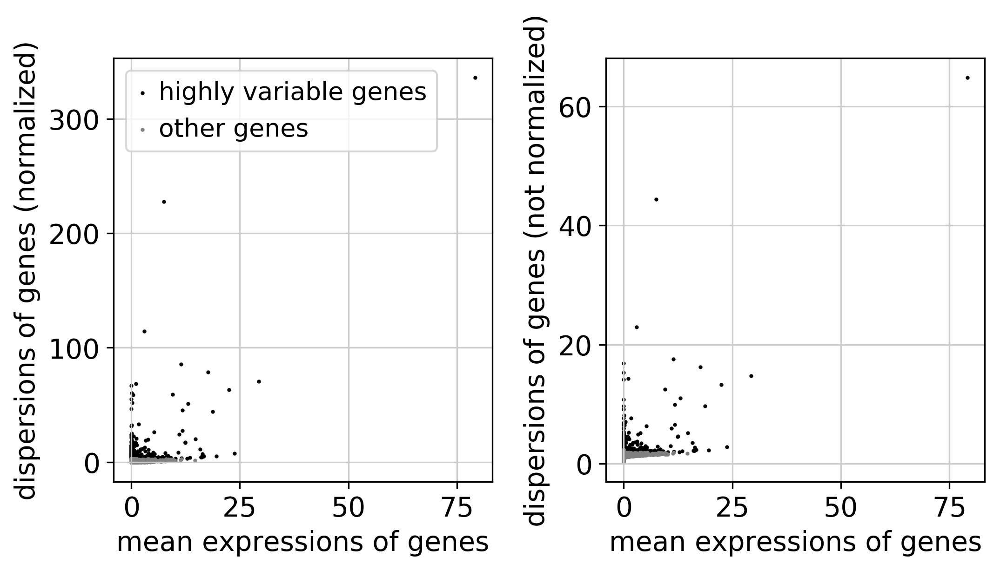

In [10]:
sc.pl.filter_genes_dispersion(filter_result, log=True)

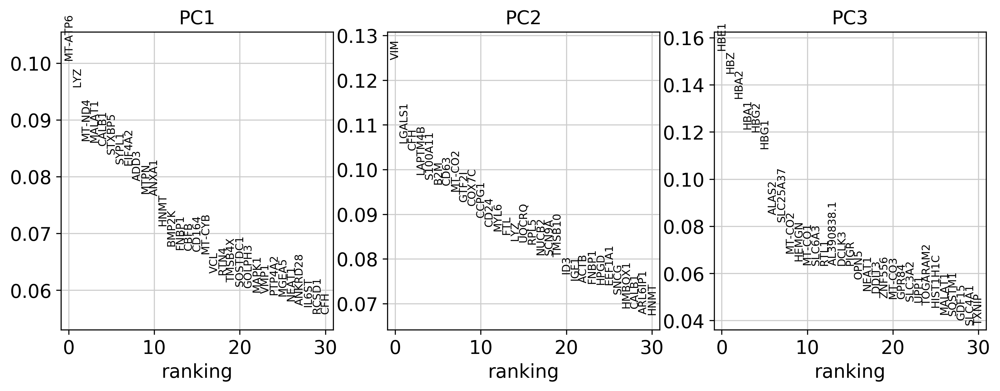

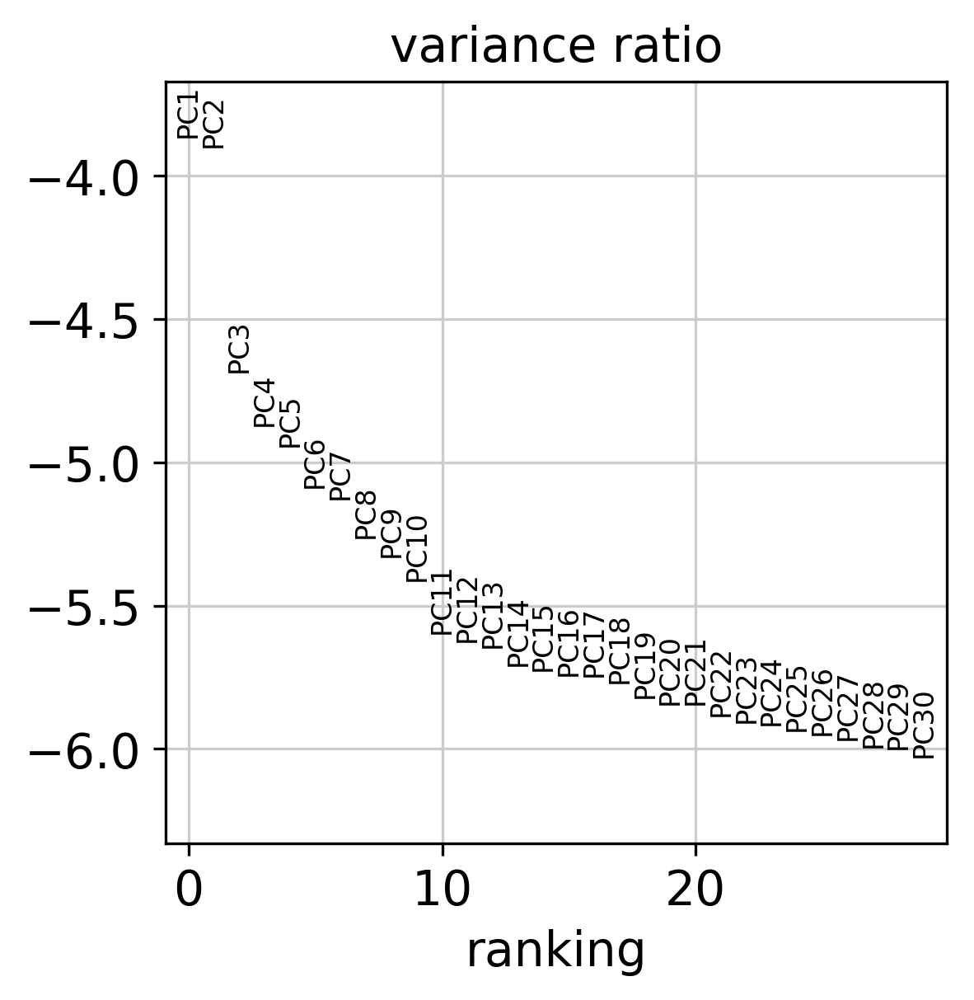

Memory usage: current 3.87 GB, difference +1.37 GB
CPU times: user 13.6 s, sys: 1.08 s, total: 14.7 s
Wall time: 3.78 s


In [11]:
%%time
# Reduce dimensions and project with highly variable genes
raw_umap = raw_k[:, filter_result.gene_subset]  # filter genes
sc.pp.normalize_per_cell(raw_umap)  # need to redo normalization after filtering
sc.pp.log1p(raw_umap)  # log transform: X = log(X + 1)
sc.pp.scale(raw_umap)
# PCA. Visualizing variance ratios can help determine an appropriate number of PCs
sc.tl.pca(raw_umap, n_comps = 30, svd_solver = "arpack")
sc.pl.pca_loadings(raw_umap)
sc.pl.pca_variance_ratio(raw_umap, log = True)
sc.logging.print_memory_usage()

In [12]:
%%time
# Calculate neighborhood graph
sc.pp.neighbors(raw_umap, n_pcs = 30)
sc.logging.print_memory_usage()

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished (0:00:09.88) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
Memory usage: current 3.89 GB, difference +0.03 GB
CPU times: user 14.9 s, sys: 1.32 s, total: 16.2 s
Wall time: 9.89 s


computing UMAP
    finished (0:00:13.37) --> added
    'X_umap', UMAP coordinates (adata.obsm)


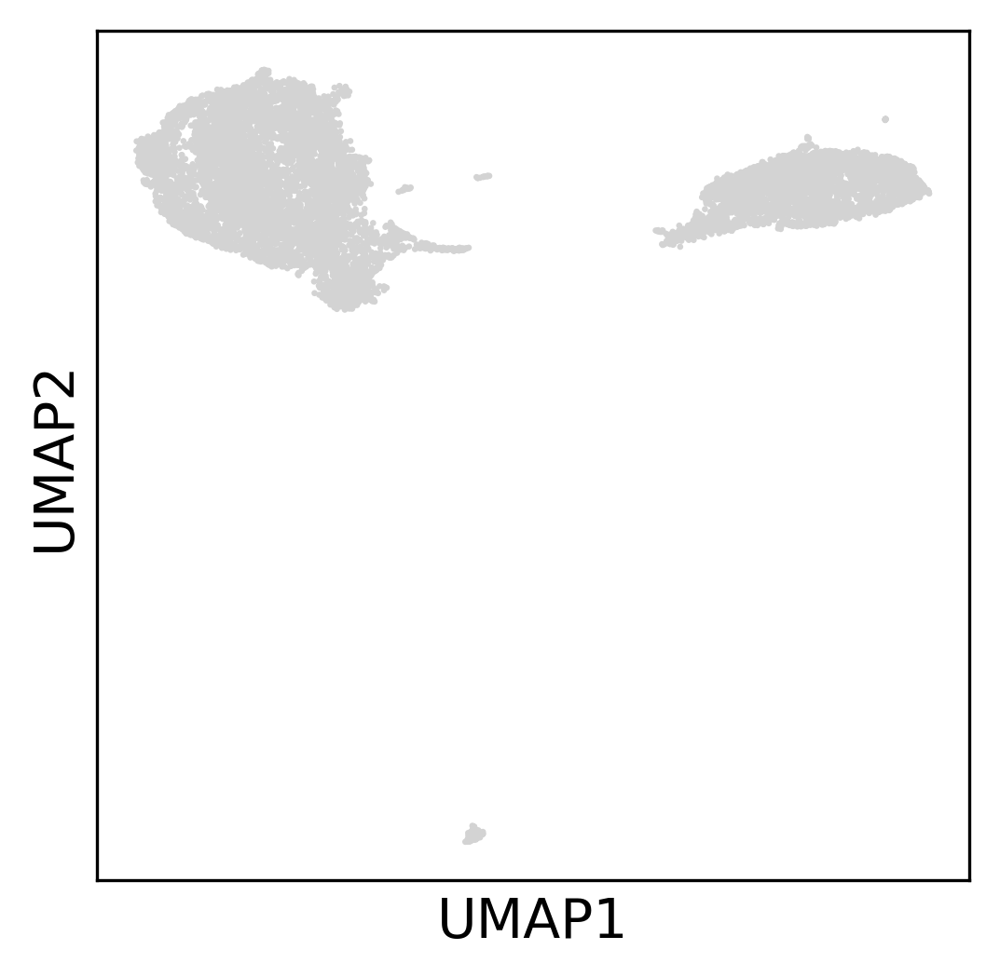

Memory usage: current 3.91 GB, difference +0.02 GB
CPU times: user 20.5 s, sys: 474 ms, total: 20.9 s
Wall time: 14 s


In [13]:
%%time
# Create the projection
sc.tl.umap(raw_umap, min_dist = 0.1) # 0.1 default from umap-learn, leads to tighter clusters
# Plot the projection
sc.pl.umap(raw_umap)
sc.logging.print_memory_usage()

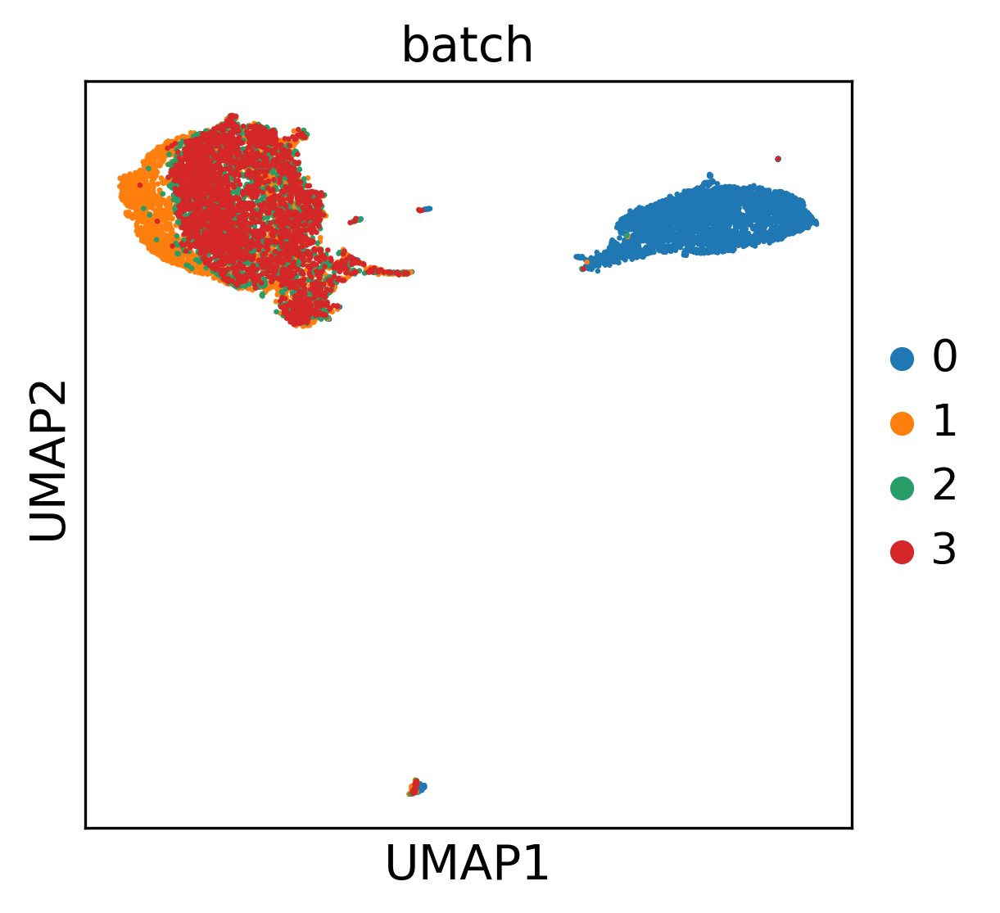

In [14]:
# Save clustering of the uncorrected batches
uncorrected_batch = sc.pl.umap(raw_umap,
                               color = "batch",
                               show = False)
uncorrected_batch.figure.savefig(k_stem + "_uncorrected.pdf",
                                 dpi = 300,
                                 transparent = True,
                                 bbox_inches = "tight")

In [15]:
raw_umap

AnnData object with n_obs × n_vars = 11912 × 1000 
    obs: 'batch', 'Cell Type', 'n_counts'
    var: 'n_counts'
    uns: 'pca', 'neighbors', 'batch_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

In [16]:
# Save the projection to the original raw data structure
raw_k.obsm = raw_umap.obsm
# Save the raw data
raw_k.write(raw_k_file)

In [17]:
%%time
# Normalize and logarithmize data before batch correction
sc.pp.normalize_per_cell(raw_k)
sc.pp.log1p(raw_k)
# Perform batch correction using mutual nearest neighbors (Haghverdi et al. 2018)
correction = sc.pp.mnn_correct(*[raw_k[raw_k.obs["batch"] == batch, :] for batch in batch_names],
                               var_subset = raw_k[:, filter_result.gene_subset].var_names,
                               var_adj = True,
                               save_raw = True,
                               sigma = 0.1, # Default in R package scran; 1.0 in mnnpy
                               index_unique = None, # index_unique = None because we have prefiltered with barcode_files
                               n_jobs = 16)

Performing cosine normalization...
Starting MNN correct iteration. Reference batch: 0
Step 1 of 3: processing batch 1
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 2 of 3: processing batch 2
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 3 of 3: processing batch 3
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
MNN correction complete. Gathering output...
Packing AnnData object...
Done.
CPU times: user 18min 4s, sys: 19.2 s, total: 18min 24s
Wall time: 2min 21s


computing neighbors
    finished (0:00:37.53) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:00:13.54) --> added
    'X_umap', UMAP coordinates (adata.obsm)
CPU times: user 1min 7s, sys: 2.23 s, total: 1min 9s
Wall time: 53.5 s


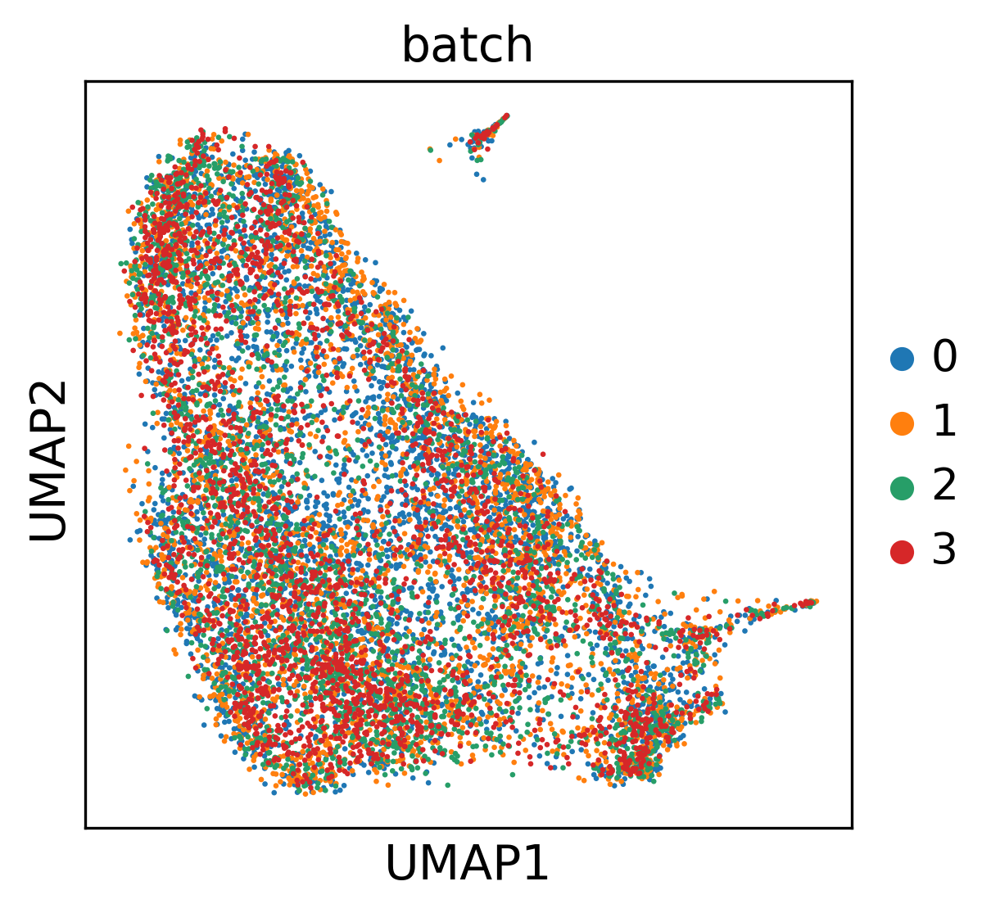

In [18]:
%%time
k_data = correction[0]
# # Project the new, batch corrected data
k_umap = k_data[:, filter_result.gene_subset]
# sc.pp.scale(corr_umap) Not scaling the corrected data yields better, more meaningful clustering
sc.pp.neighbors(k_umap,
                use_rep = 'X',
                n_neighbors = 15) # Default: 15
sc.tl.umap(k_umap, min_dist = 0.1)
# Plot and save the batch corrected clustring
corrected_batch = sc.pl.umap(k_umap,
                             color = "batch",
                             show = False)
corrected_batch.figure.savefig(k_stem + "_corrected.pdf",
                               dpi = 300,
                               transparent = True,
                               bbox_inches = "tight")

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:01.53) --> found 7 clusters and added
    'louvain', the cluster labels (adata.obs, categorical)


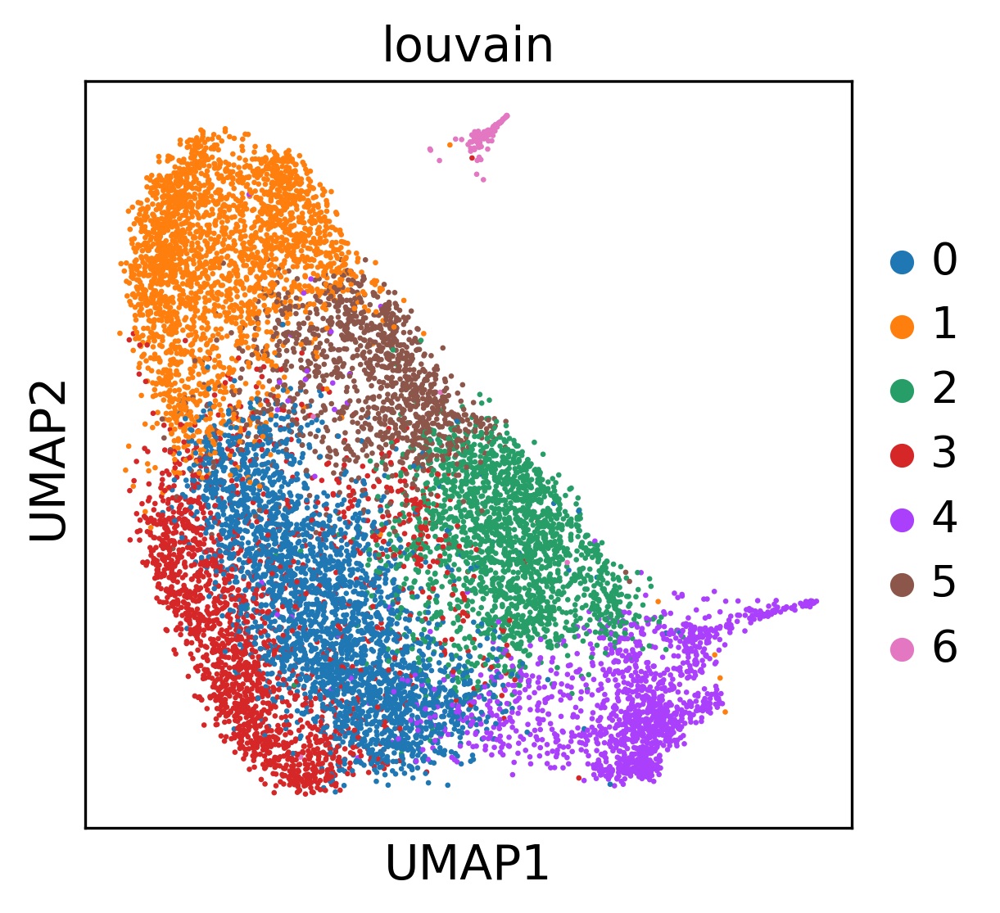

Memory usage: current 8.55 GB, difference +0.00 GB
CPU times: user 4.4 s, sys: 225 ms, total: 4.62 s
Wall time: 2.59 s


In [35]:
%%time
# Find clusters (lower resolution results in fewer clusters)
# Needs to happen on the re-projection subset
sc.tl.louvain(k_umap, resolution = 1)
sc.pl.umap(k_umap, color = ["louvain"])
sc.logging.print_memory_usage()

saving figure to file ./figures/pca_loadingsK562-HyPB_corrected_pca_loadings.pdf


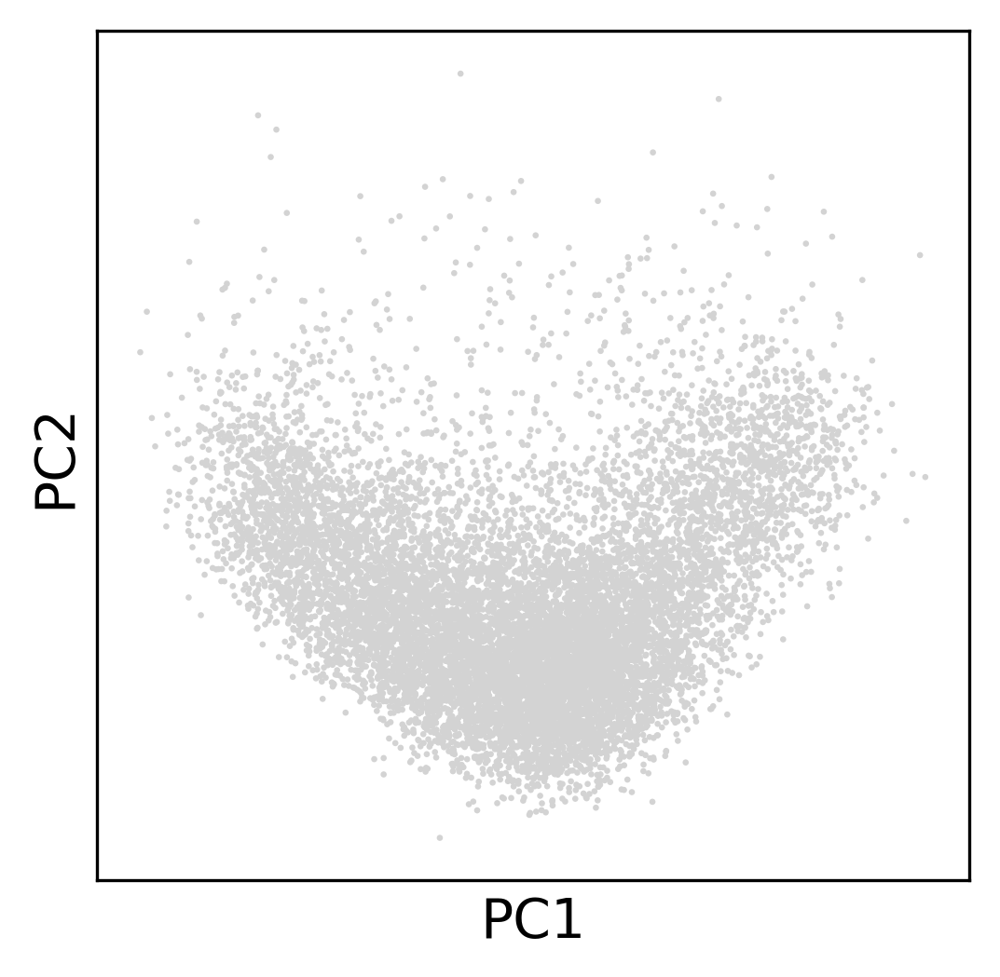

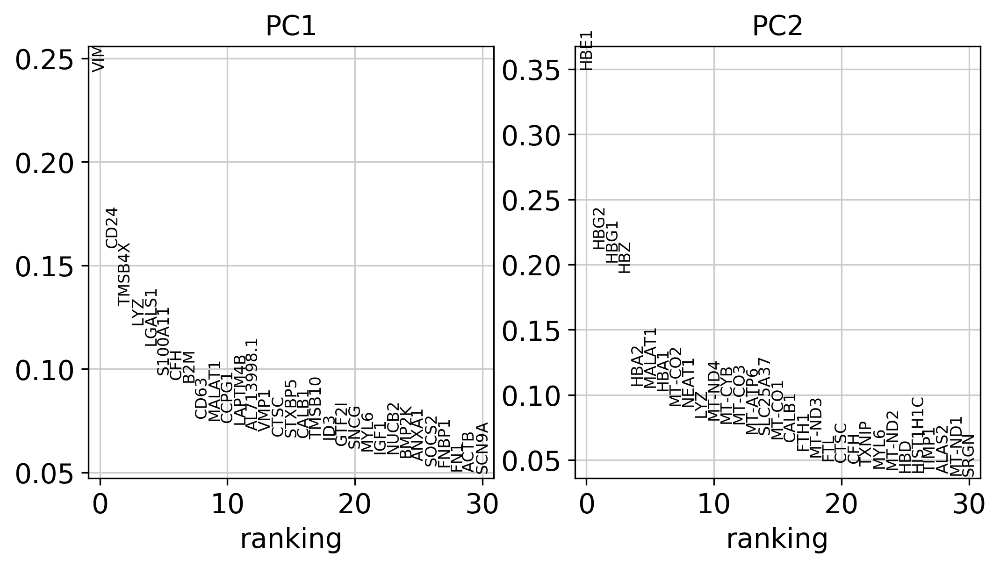

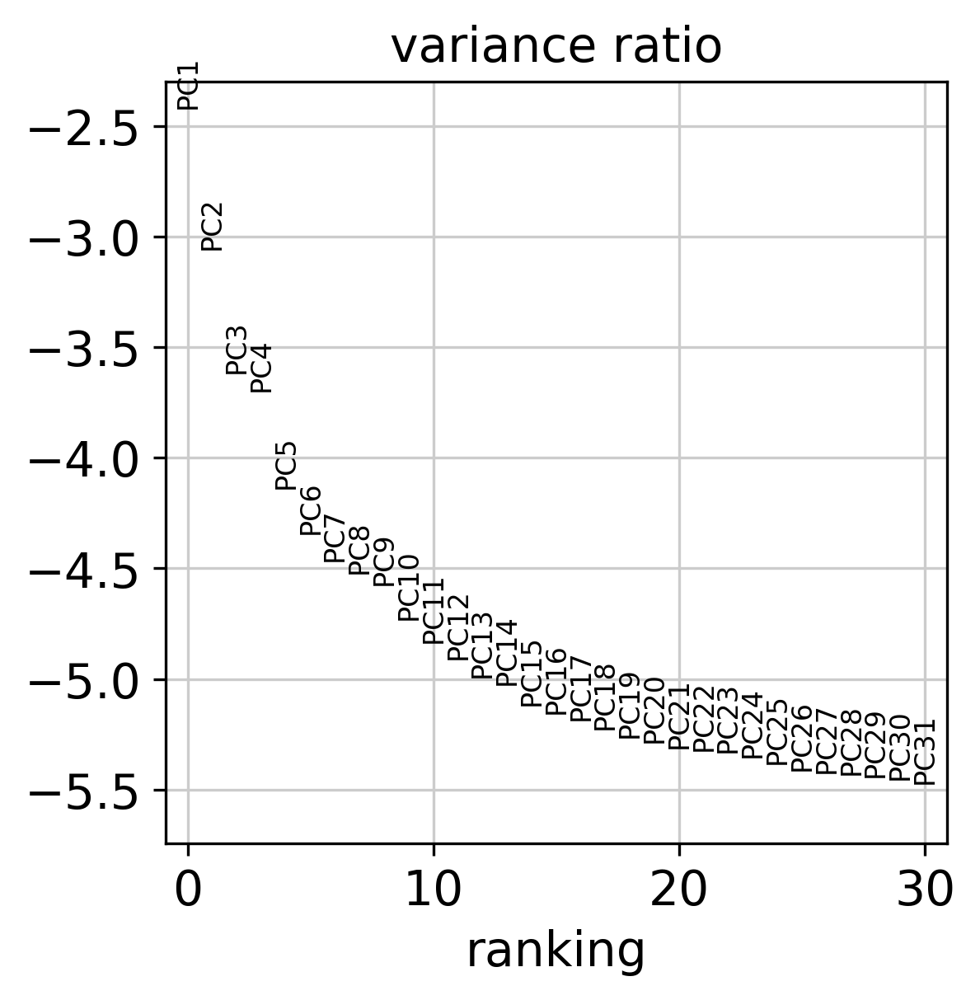

In [36]:
# Calculate PCAs on the batch-corrected dataset
sc.tl.pca(k_umap, svd_solver = "arpack")
k_pca = sc.pl.pca(k_umap, show=False)
k_pca.figure.savefig(k_stem + "_corrected_pca.pdf", 
                     dpi=300,
                     transparent=True,
                     bbox_inches="tight")
k_pca_loadings = sc.pl.pca_loadings(k_umap,
                                    components=[1,2],
                                    show=True,
                                    save="K562-HyPB_corrected_pca_loadings.pdf")
sc.pl.pca_variance_ratio(k_umap, log = True)
# Afterwards, move K562-HyPB_corrected_pca_loadings.pdf to directory

In [37]:
# Save the new projection to the larger dataset
k_data.obsm = k_umap.obsm
k_data.uns = k_umap.uns
# k_data.varm = k_umap.varm
k_data.obs["louvain"] = k_umap.obs["louvain"]
# Save files to disk
k_data.write(k_file)
k_umap.write(umap_k_file)
raw_k.write(raw_k_file)

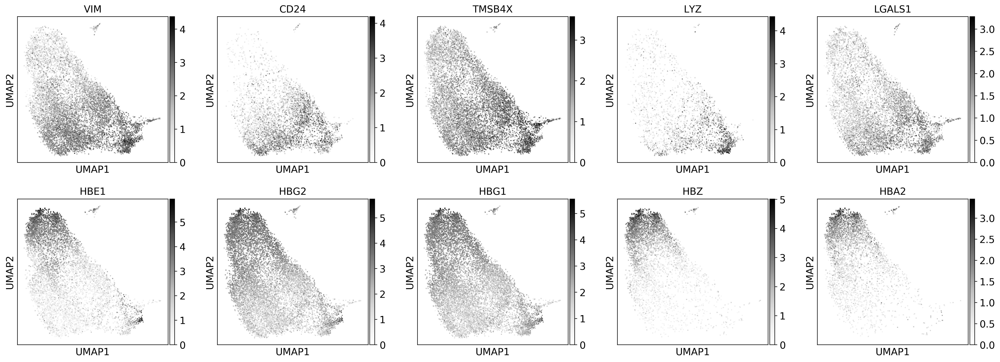

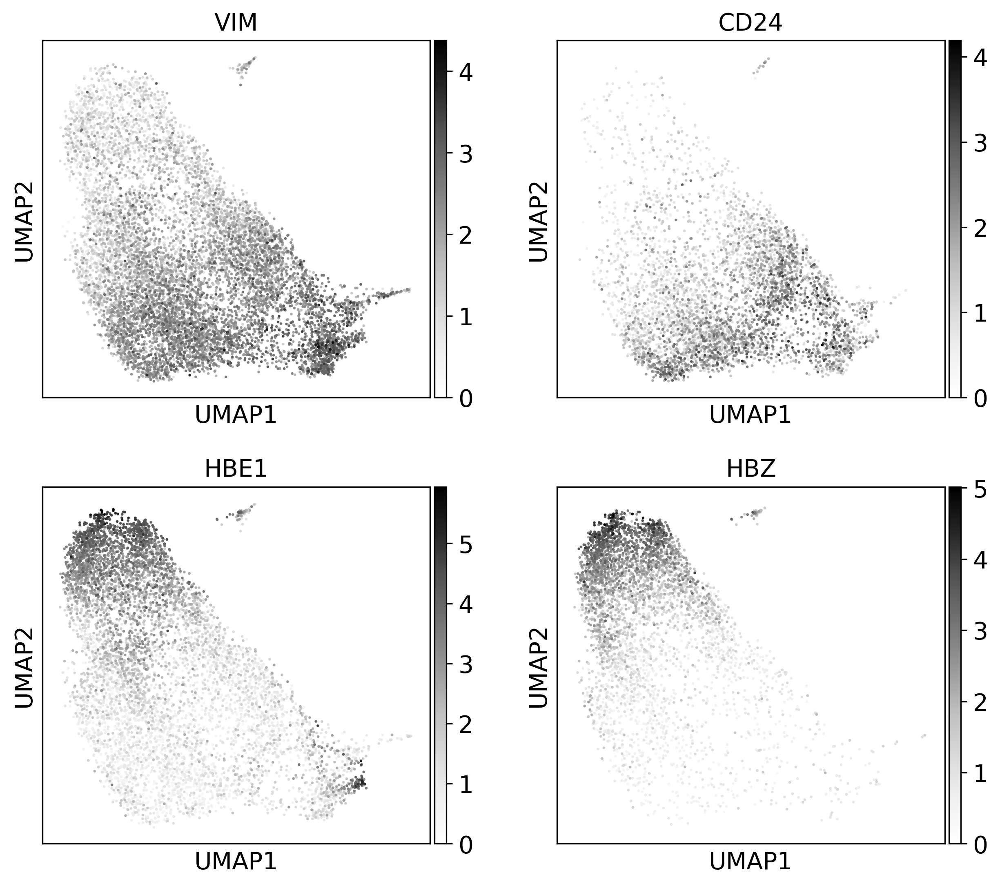

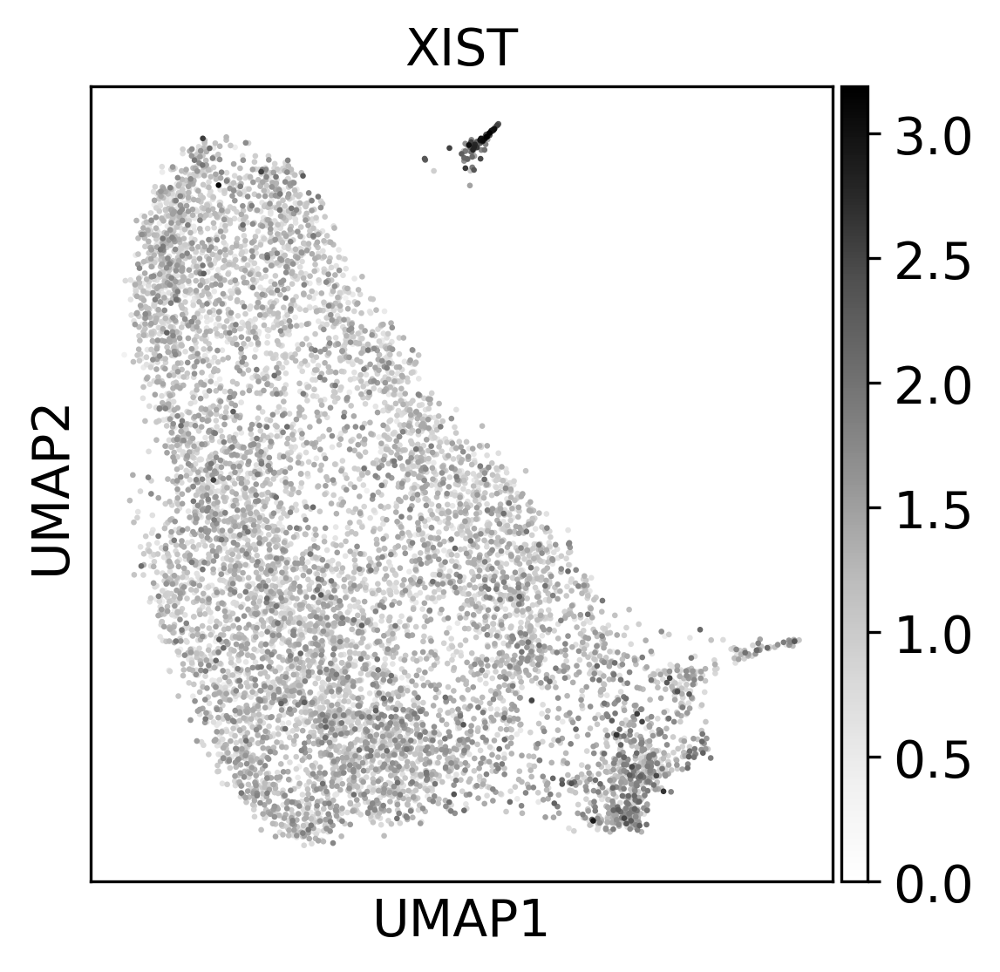

In [38]:
# Make some figures
k_topPC_umap10 = sc.pl.umap(k_data,
                            color=["VIM", "CD24", "TMSB4X", "LYZ", "LGALS1", "HBE1", "HBG2", "HBG1", "HBZ", "HBA2"],
                            color_map="Greys",
                            ncols=5,
                            show=False)[0]
k_topPC_umap10.figure.savefig(k_stem + "_topPC10_umap.pdf",
                              dpi=300,
                              transparent=True,
                              bbox_inches="tight")

k_topPC_umap4 = sc.pl.umap(k_data,
                           color=["VIM", "CD24", "HBE1", "HBZ"],
                           color_map="Greys",
                           ncols=2,
                           show=False)[0]
k_topPC_umap4.figure.savefig(k_stem + "_topPC4_umap.pdf",
                             dpi=300,
                             transparent=True,
                             bbox_inches="tight")

k_xist_umap = sc.pl.umap(k_data,
                         color=["XIST"],
                         color_map="Greys",
                         ncols=1,
                         show=False)
k_xist_umap.figure.savefig(k_stem + "_XIST_umap.pdf", 
                           dpi=300,
                           transparent=True,
                           bbox_inches="tight")

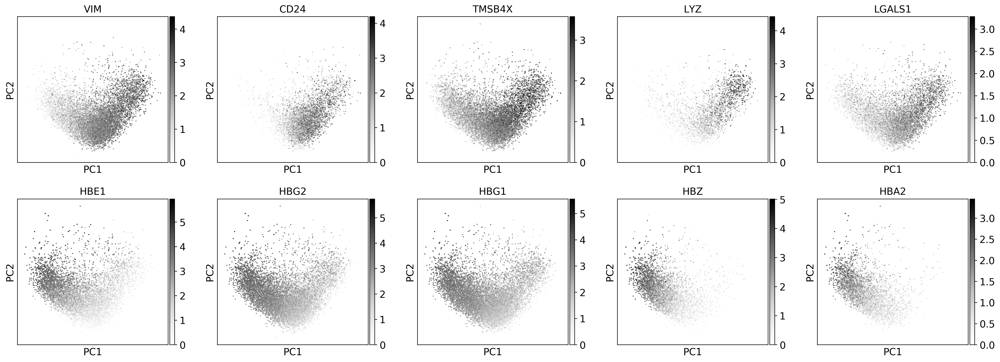

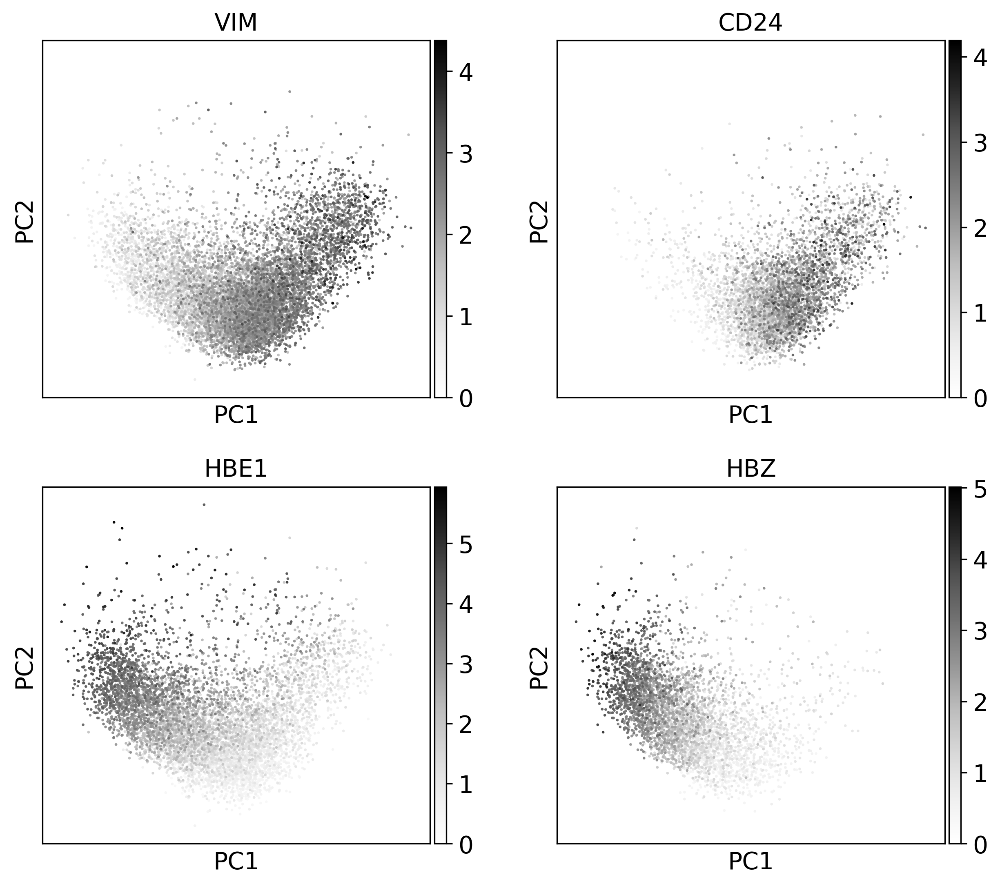

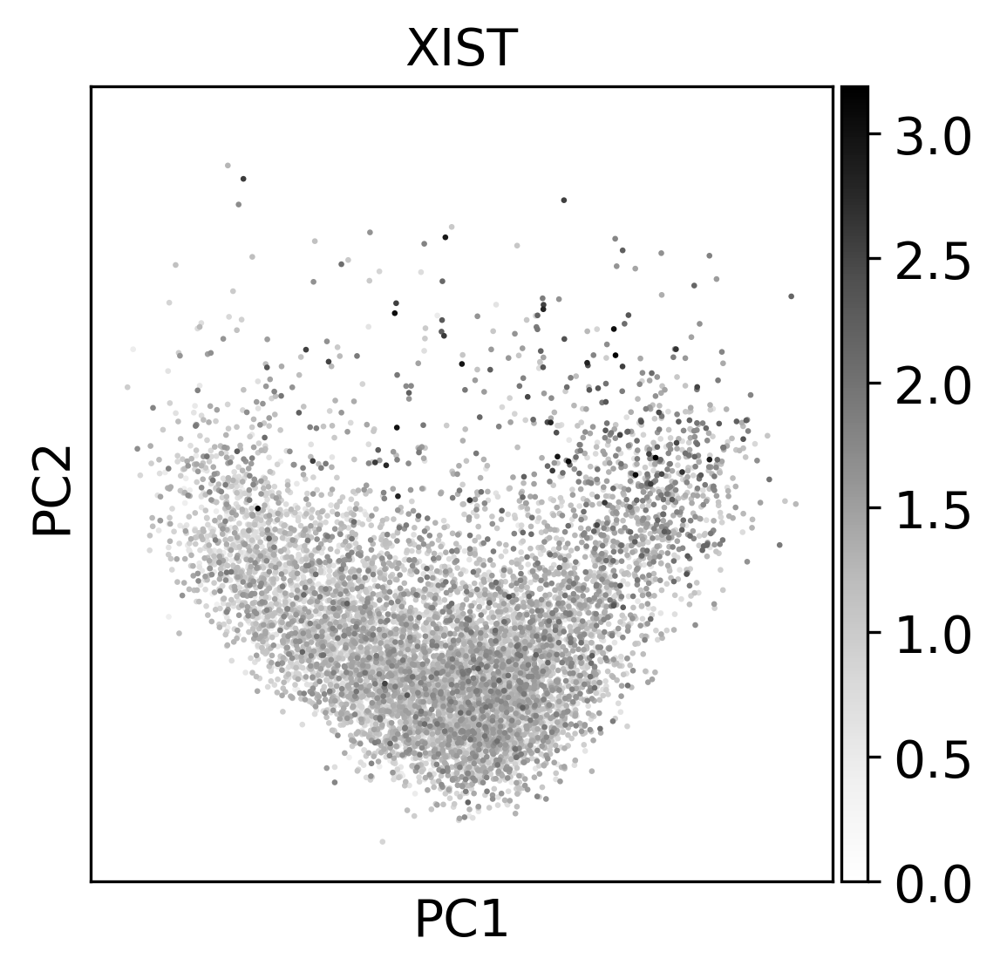

In [39]:
# Make some figures
k_topPC_pca10 = sc.pl.pca(k_data,
                          color=["VIM", "CD24", "TMSB4X", "LYZ", "LGALS1", "HBE1", "HBG2", "HBG1", "HBZ", "HBA2"],
                          color_map="Greys",
                          ncols=5,
                          show=False)[0]
k_topPC_pca10.figure.savefig(k_stem + "_topPC10_pca.pdf",
                             dpi=300,
                             transparent=True,
                             bbox_inches="tight")

k_topPC_pca4 = sc.pl.pca(k_data,
                         color=["VIM", "CD24", "HBE1", "HBZ"],
                         color_map="Greys",
                         ncols=2,
                         show=False)[0]
k_topPC_pca4.figure.savefig(k_stem + "_topPC4_pca.pdf",
                            dpi=300,
                            transparent=True,
                            bbox_inches="tight")

k_xist_pca = sc.pl.pca(k_data,
                       color=["XIST"],
                       color_map="Greys",
                       ncols=1,
                       show=False)
k_xist_pca.figure.savefig(k_stem + "_XIST_pca.pdf", 
                          dpi=300,
                          transparent=True,
                          bbox_inches="tight")

#### Pseudotime analysis

drawing single-cell graph using layout "fa"
    finished (0:01:44.63) --> added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm)


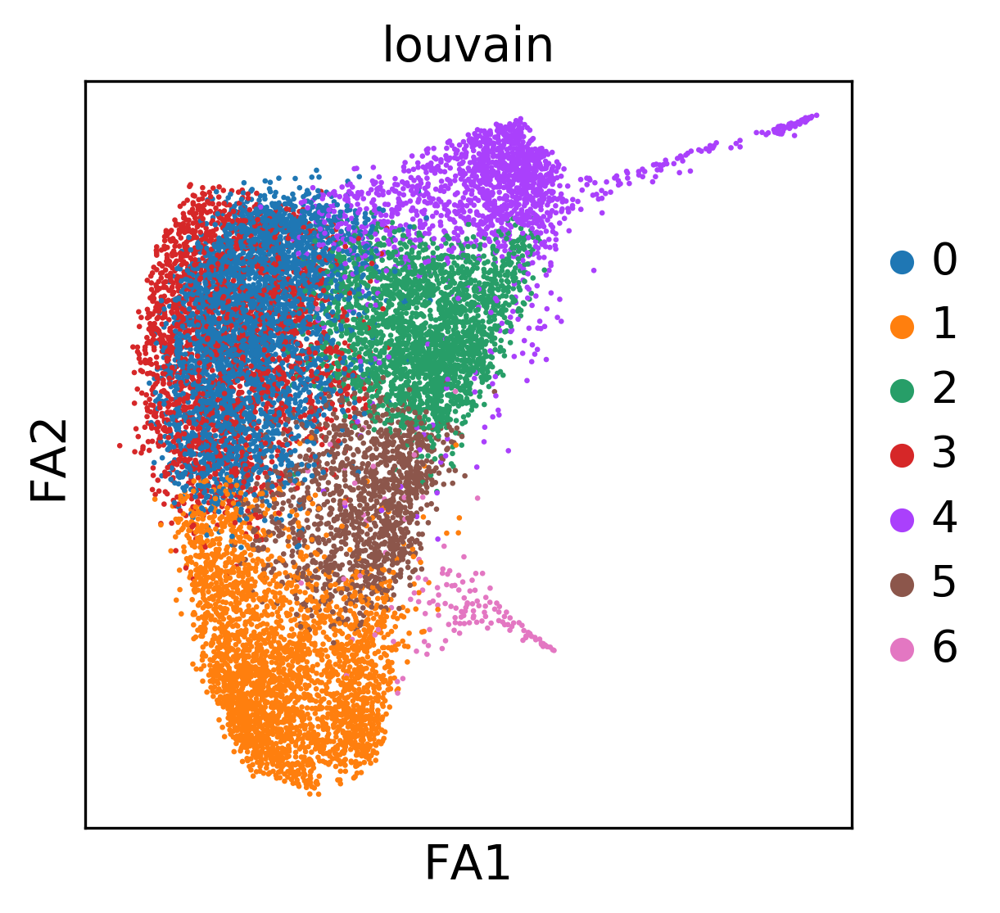

In [40]:
# Let's try trajectory analysis
# Draw a graph embedding
sc.tl.draw_graph(k_data)
sc.pl.draw_graph(k_data, color = "louvain")

running PAGA
    finished (0:00:00.32) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
--> added 'pos', the PAGA positions (adata.uns['paga'])


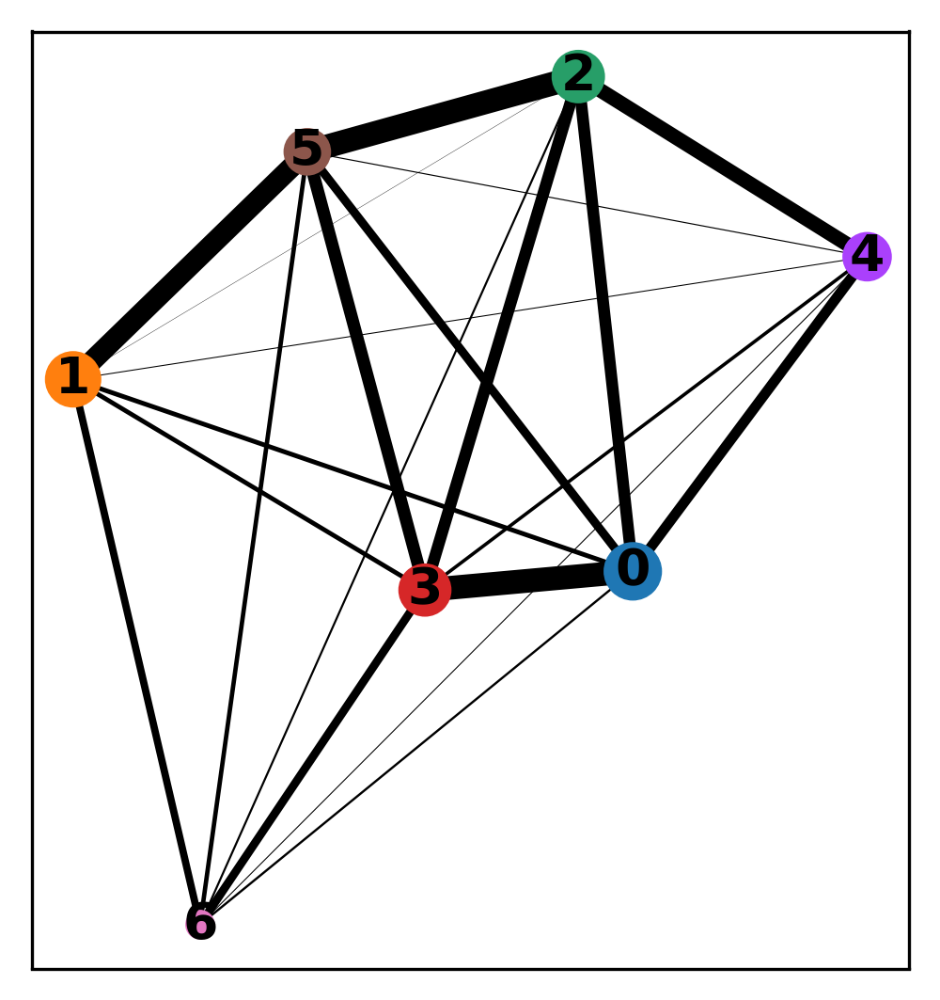

In [41]:
# Infer trajectories using PAGA
sc.tl.paga(k_data, groups = "louvain")
# Visualize trajectory graph
sc.pl.paga(k_data, color = "louvain")

--> added 'pos', the PAGA positions (adata.uns['paga'])


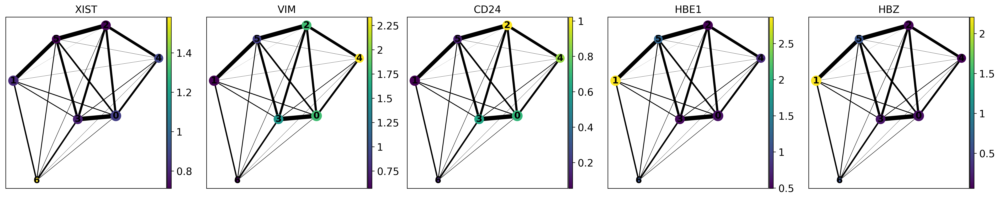

In [42]:
sc.pl.paga(k_data, color = ["XIST", "VIM", "CD24", "HBE1", "HBZ"])

There does not seem to be any clear trajectories that emerge

#### Cell state mixture modeling

In [59]:
sc.tl.score_genes(k_data, ["VIM", "TMSB4X"],
                  score_name = "stem_score", random_state=0)
sc.tl.score_genes(k_data, ["HBG2", "HBG1"],
                  score_name = "diff_score", random_state=0)

computing score 'stem_score'
    finished (0:00:02.31) --> added
    'stem_score', score of gene set (adata.obs)
computing score 'diff_score'
    finished (0:00:02.27) --> added
    'diff_score', score of gene set (adata.obs)


In [60]:
k_data.obs["score"] = k_data.obs["diff_score"] - k_data.obs["stem_score"]
min_score, max_score = np.min(k_data.obs["score"]), np.max(k_data.obs["score"])
scale_limit = np.min(np.abs([min_score, max_score]))

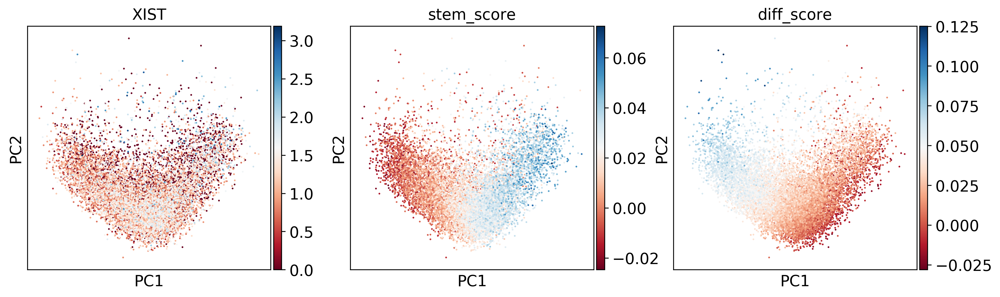

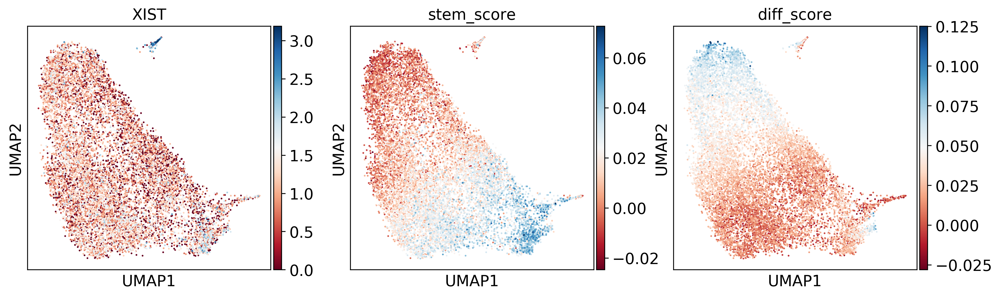

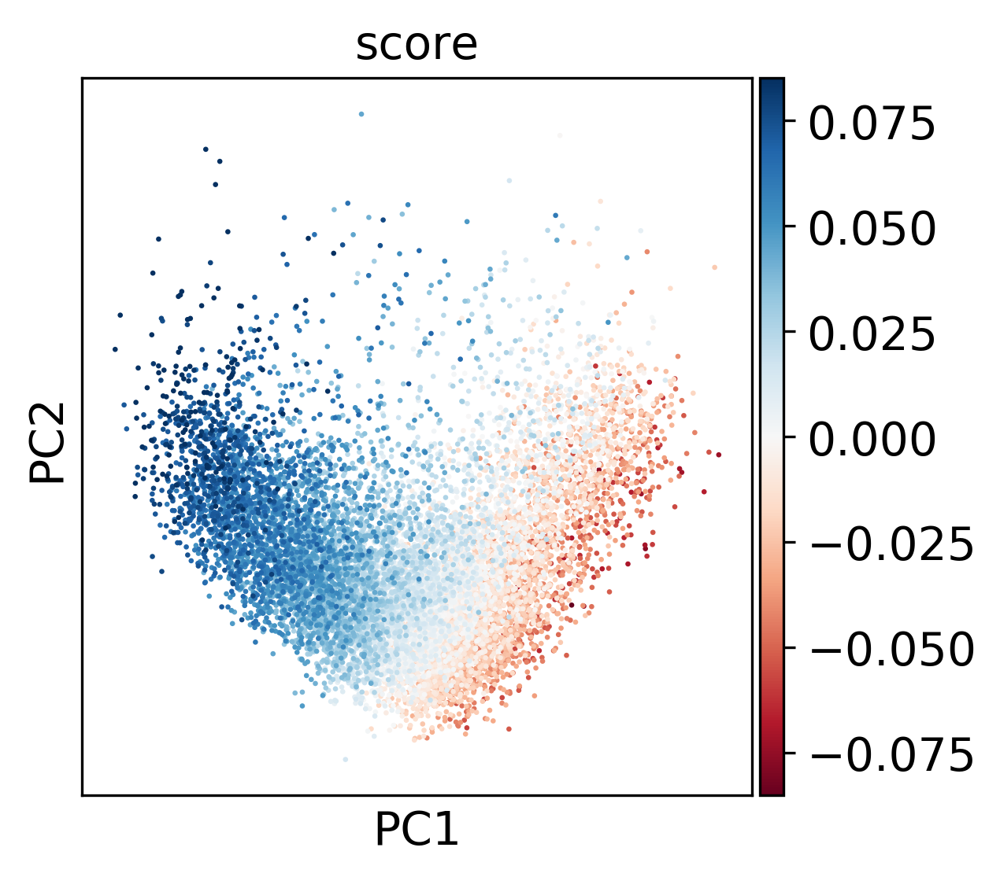

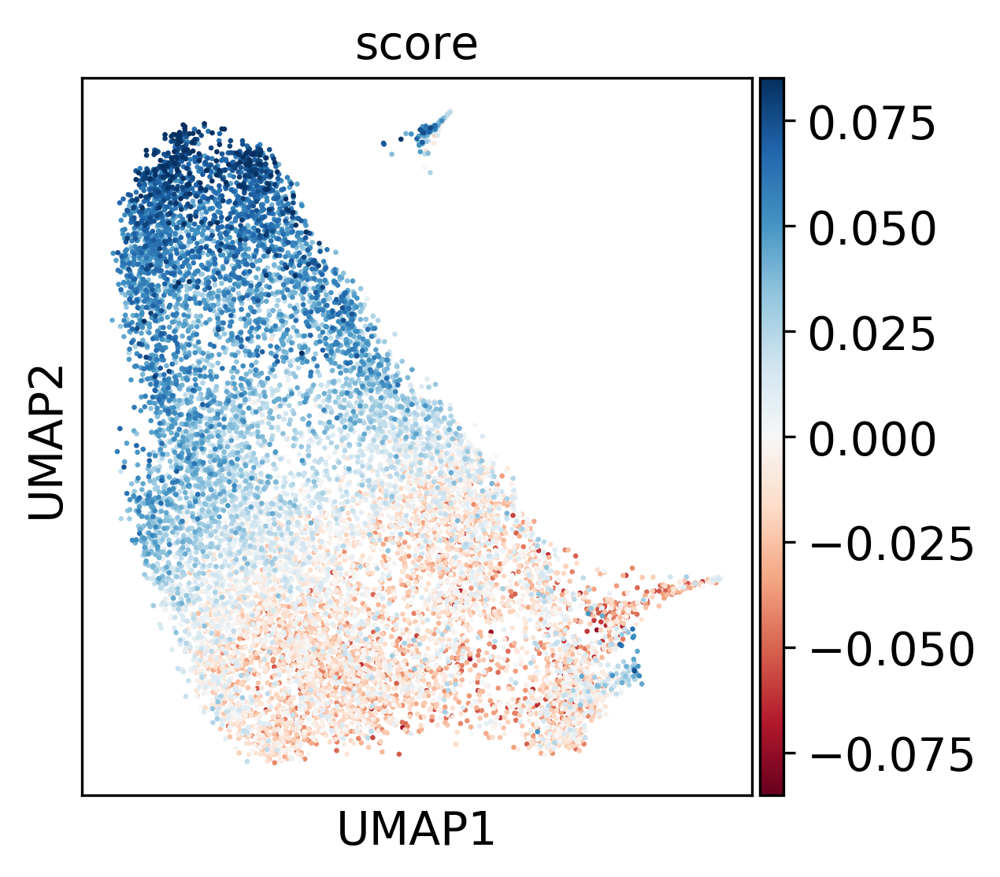

In [61]:
sc.pl.pca(k_data, color=["XIST", "stem_score", "diff_score"], color_map="RdBu")
sc.pl.umap(k_data, color=["XIST", "stem_score", "diff_score"], color_map="RdBu")
k_state_pca = sc.pl.pca(k_data,
                        color="score",
                        color_map="RdBu",
                        vmin=-scale_limit,
                        vmax=scale_limit,
                        show=False)
k_state_pca.figure.savefig(k_stem + "_score_pca.pdf",
                           dpi=300,
                           transparent=True,
                           bbox_inches="tight")
k_state_umap = sc.pl.umap(k_data,
                          color="score",
                          color_map="RdBu",
                          vmin=-scale_limit,
                          vmax=scale_limit,
                          show=False)
k_state_umap.figure.savefig(k_stem + "_score_umap.pdf",
                            dpi=300,
                            transparent=True,
                            bbox_inches="tight")

In [62]:
bins = np.linspace(np.min(k_data.obs["score"]), np.max(k_data.obs["score"]), 100)
weights = np.ones_like(k_data.obs["score"]) / len(k_data.obs["score"])

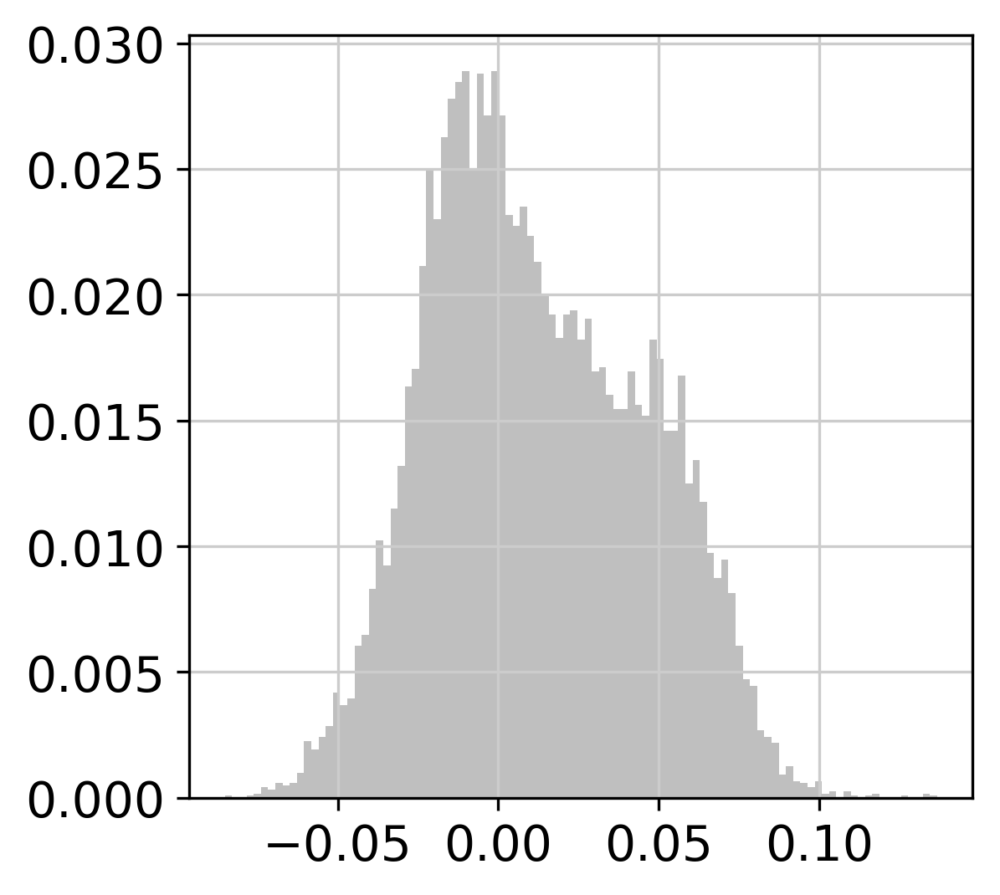

In [63]:
fig = plt.figure()
ax = fig.gca()
n, b, p = ax.hist(k_data.obs["score"], weights = weights, bins = bins, color = "grey", alpha = 0.5)

In [64]:
from sklearn import mixture
X = np.array(k_data.obs["score"]).reshape(-1, 1)
gmm = mixture.GaussianMixture(n_components=3, covariance_type="full", tol=1e-5, random_state=0)
gmm.fit(X)
print(np.ravel(gmm.means_), np.ravel(gmm.covariances_), np.ravel(gmm.weights_))

[ 0.0073518   0.04996127 -0.01436969] [0.00040549 0.0003486  0.00037365] [0.30806441 0.30724245 0.38469314]


In [65]:
responsibilities = gmm.predict_proba(bins.reshape(-1, 1))
logprob = gmm.score_samples(bins.reshape(-1, 1))
pdf = np.exp(logprob)
pdf_individual = responsibilities * pdf[:, np.newaxis]

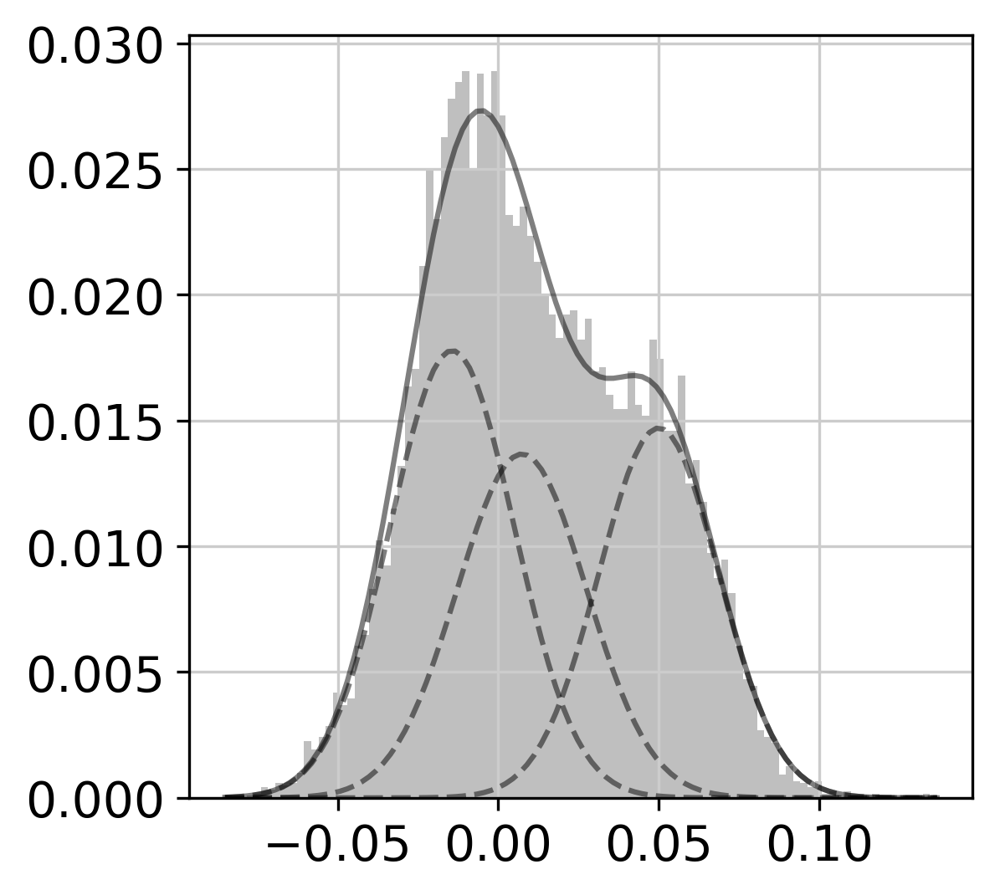

In [66]:
fig = plt.figure()
ax = plt.gca()
weights = np.ones_like(X)/len(X)
n, b, p = ax.hist(X, bins = bins, color = "grey", weights = weights, label = None, alpha = 0.5)
ax.plot(bins, pdf/np.sum(pdf), '-k', alpha = 0.5)
ax.plot(bins, pdf_individual/np.sum(pdf), '--k', alpha = 0.5)

In [67]:
# Estimate intersections of these curves to arrive at empirical cutoffs
# to define stem and diff populations
# Get PDFs for each distribution
pdf1 = np.array([_[0] for _ in pdf_individual/np.sum(pdf)])
pdf2 = np.array([_[1] for _ in pdf_individual/np.sum(pdf)])
pdf3 = np.array([_[2] for _ in pdf_individual/np.sum(pdf)])
# Find the last index for which pdf1 > pdf2
index1 = np.where(pdf3 > pdf1)[0][-1]
# Linear interpolation between index1 and index1 + 1
# to smoothly estimate the x-coordinate of the intersection
intersection1 = (bins[index1] + bins[index1 + 1]) / 2
# Repeat for the second intersection point
index2 = np.where(pdf1 > pdf2)[0][-1]
intersection2 = (bins[index2] + bins[index2 + 1]) / 2

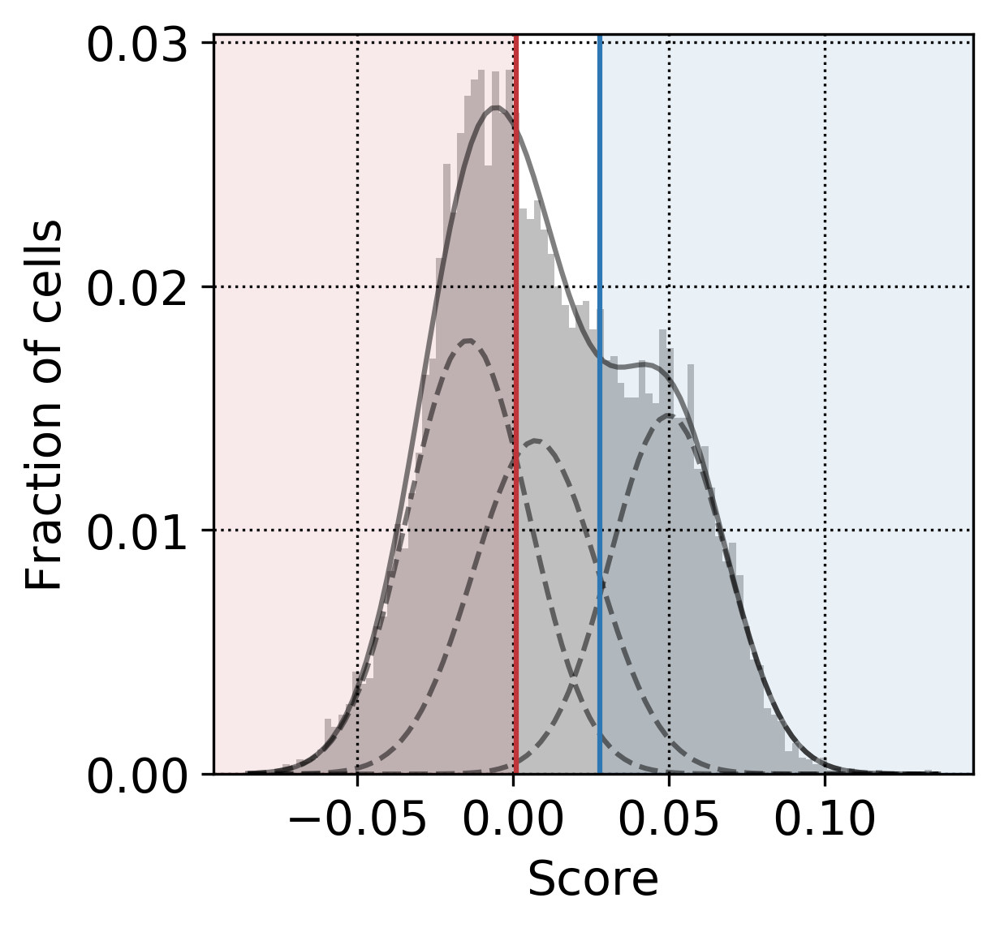

In [68]:
# Plot the fitted distribution but now mark the intersections
fig = plt.figure()
ax = plt.gca()
weights = np.ones_like(X)/len(X)
n, b, p = ax.hist(X, bins = bins, color = "grey", weights = weights, label = None, alpha = 0.5)
ax.plot(bins, pdf/np.sum(pdf), '-k', alpha=0.5)
ax.plot(bins, pdf_individual/np.sum(pdf), '--k', alpha=0.5)
left, right = ax.get_xlim()
ax.axvline(x=intersection1, color="#C03539")
ax.axvspan(xmin=left, xmax=intersection1, color="#C03539", alpha=0.1)
ax.axvline(x=intersection2, color="#2D77B5")
ax.axvspan(xmin=intersection2, xmax=right, color="#2D77B5", alpha=0.1)
ax.set_xlim(left, right)
ax.set_yticks([0, 0.01, 0.02, 0.03])
ax.grid(color='k', linestyle=':')
ax.set_xlabel("Score")
ax.set_ylabel("Fraction of cells")
plt.savefig(k_stem + "_GMM.pdf", transparent=True, bbox_inches="tight")

In [69]:
# Filter cells by cutoffs
k_stemlike = k_data[k_data.obs["score"] < intersection1]
k_diff = k_data[k_data.obs["score"] > intersection2]

... storing 'state' as categorical


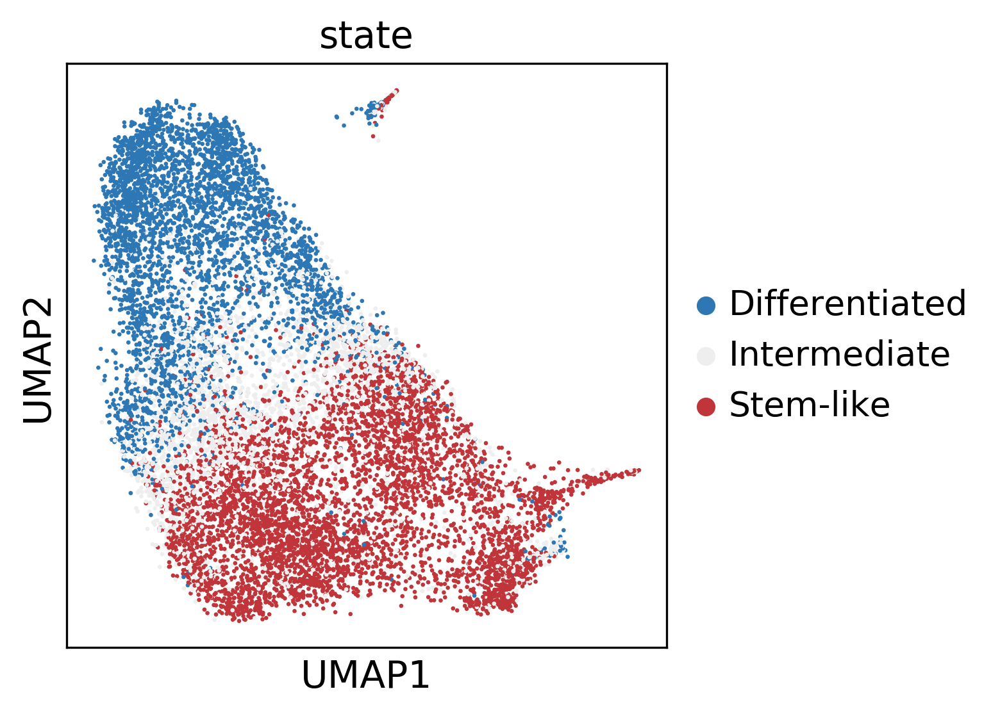

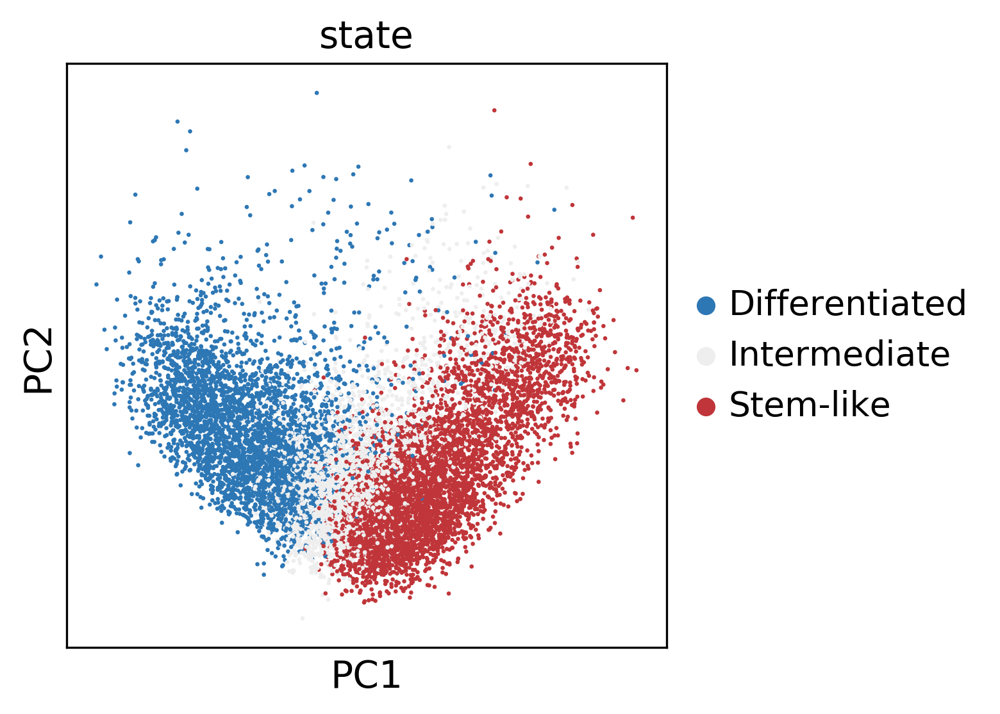

In [70]:
# Annotate stem-like and differentiated clusters
k_data.obs["state"] = "Intermediate"
for index in k_stemlike.obs.index:
    k_data.obs.at[index, "state"] = "Stem-like"
for index in k_diff.obs.index:
    k_data.obs.at[index, "state"] = "Differentiated"
# Visualize
k_states_umap = sc.pl.umap(k_data,
                           color="state",
                           palette=["#2D77B5", "#EEEEEE", "#C03539"],
                           show=False)
k_states_umap.figure.savefig(k_stem + "_states_umap.pdf", 
                             dpi=300,
                             transparent=True,
                             bbox_inches="tight")
k_states_pca = sc.pl.pca(k_data,
                         color="state",
                         palette=["#2D77B5", "#EEEEEE", "#C03539"],
                         show=False)
k_states_pca.figure.savefig(k_stem + "_states_pca.pdf", 
                            dpi=300,
                            transparent=True,
                            bbox_inches="tight")

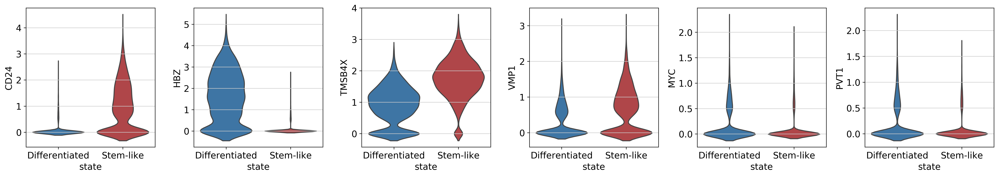

In [71]:
k_extrema = k_data[k_data.obs["state"] != "Intermediate"]
violin = sc.pl.violin(k_extrema,
                      ["CD24", "HBZ", "TMSB4X", "VMP1", "MYC", "PVT1"],
                      groupby="state",
                      palette=["#2D77B5", "#C03539"],
                      var_group_rotation=90,
                      stripplot=False,
                      jitter=False,
                      show=False)[0]
violin.figure.savefig(k_stem + "_key_genes_violin.pdf",
                      dpi=300,
                      transparent=True,
                      bbox_inches="tight")

In [72]:
# Save barcodes
pd.DataFrame(k_stemlike.obs.index).to_csv(k_stem + "_stem_barcodes.csv", header = None, index = False)
pd.DataFrame(k_diff.obs.index).to_csv(k_stem + "_diff_barcodes.csv", header = None, index = False)

In [73]:
# Final save
k_data.write(k_file)
# Save as .loom
scanpyToLoom(k_data, k_stem + ".loom", "K562_HyPBase_scRNA")

Wrote ../output_and_analysis/reanalysis/K562-HyPB.loom


### Process HCT-116 data

In [74]:
%%time
# Find highly variable genes for HCT-116 dimensionality reduction and projection
sc.pp.filter_genes(raw_h, min_counts=1)  # only consider genes with more than 1 count
sc.pp.normalize_per_cell(raw_h)          # normalize with total UMI count per cell
filter_result = sc.pp.filter_genes_dispersion(raw_h.X,
                                              flavor = 'cell_ranger',
                                              n_top_genes = 1000,
                                              log = False)

filtered out 9688 genes that are detected in less than 1 counts
CPU times: user 13.8 s, sys: 1.23 s, total: 15.1 s
Wall time: 1.45 s


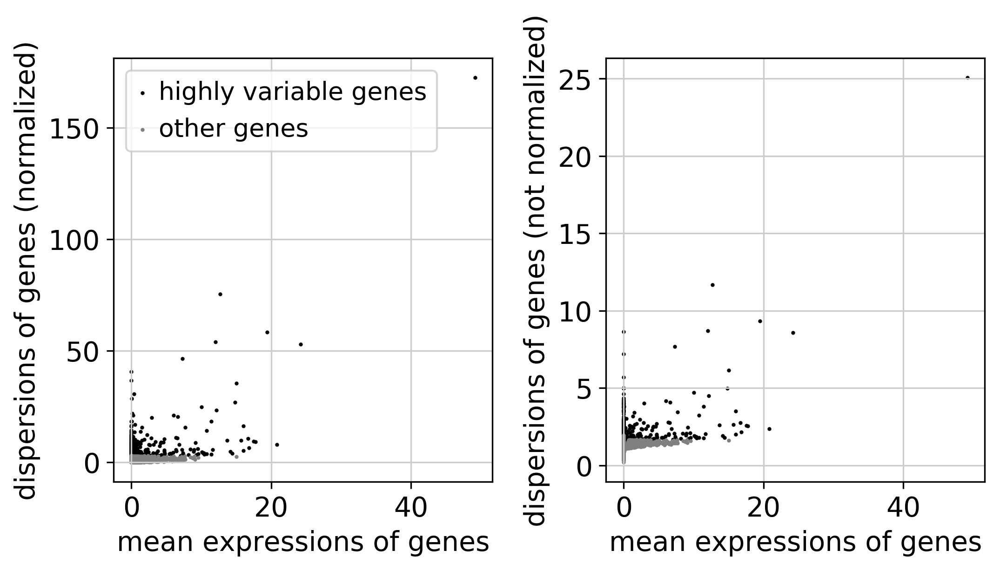

In [75]:
sc.pl.filter_genes_dispersion(filter_result, log=True)

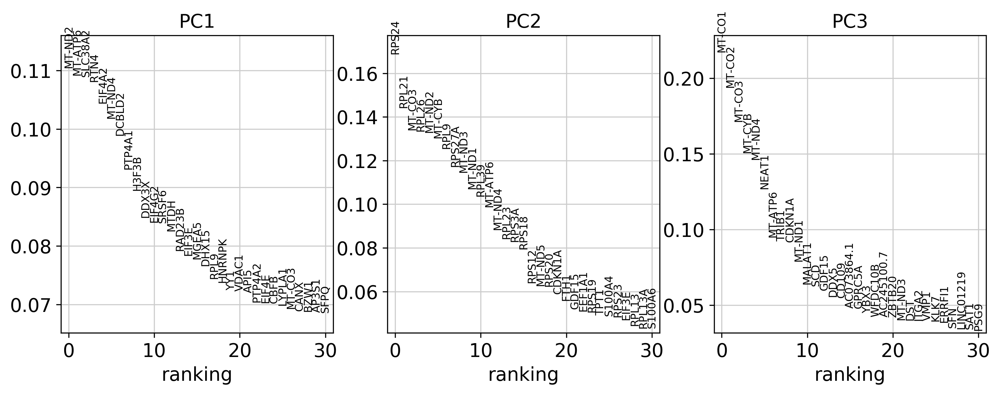

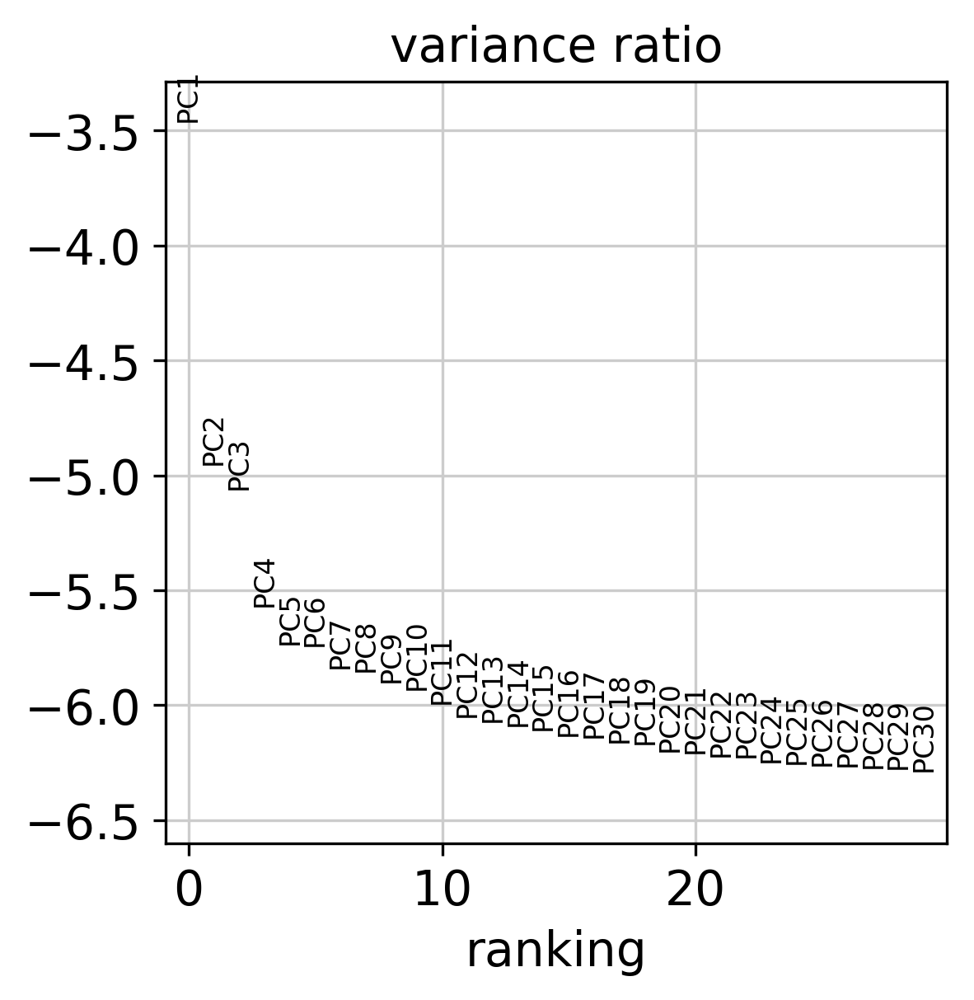

Memory usage: current 11.03 GB, difference -0.99 GB
CPU times: user 9.92 s, sys: 460 ms, total: 10.4 s
Wall time: 3.05 s


In [76]:
%%time
# Reduce dimensions and project with highly variable genes
raw_umap = raw_h[:, filter_result.gene_subset]  # filter genes
sc.pp.normalize_per_cell(raw_umap)  # need to redo normalization after filtering
sc.pp.log1p(raw_umap)  # log transform: X = log(X + 1)
sc.pp.scale(raw_umap)
# PCA. Visualizing variance ratios can help determine an appropriate number of PCs
sc.tl.pca(raw_umap, n_comps = 30, svd_solver = "arpack")
sc.pl.pca_loadings(raw_umap)
sc.pl.pca_variance_ratio(raw_umap, log = True)
sc.logging.print_memory_usage()

In [77]:
%%time
# Calculate neighborhood graph
sc.pp.neighbors(raw_umap, n_pcs = 30)
sc.logging.print_memory_usage()

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished (0:00:04.41) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
Memory usage: current 10.37 GB, difference -0.66 GB
CPU times: user 9.7 s, sys: 1.22 s, total: 10.9 s
Wall time: 4.42 s


computing UMAP
    finished (0:00:12.71) --> added
    'X_umap', UMAP coordinates (adata.obsm)


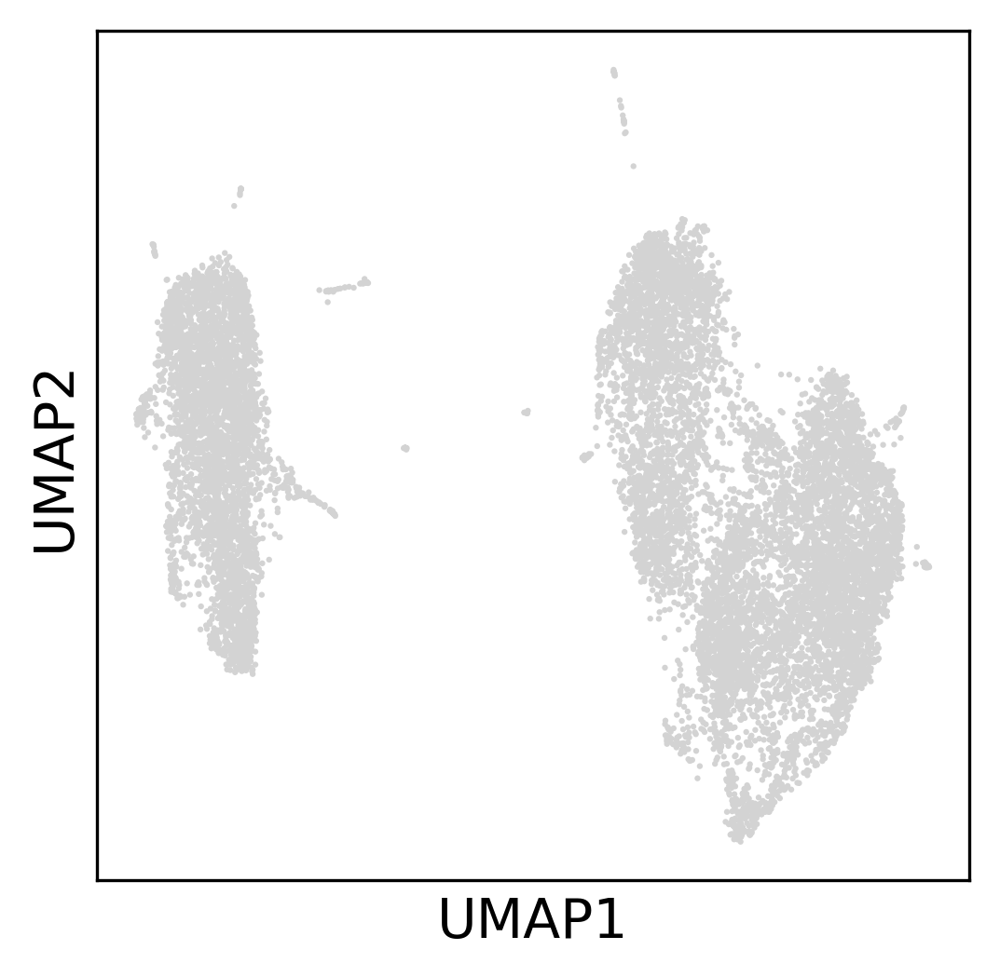

Memory usage: current 10.37 GB, difference +0.00 GB
CPU times: user 18.2 s, sys: 425 ms, total: 18.6 s
Wall time: 13.4 s


In [78]:
%%time
# Create the projection
sc.tl.umap(raw_umap, min_dist = 0.1) # 0.1 default from umap-learn, leads to tighter clusters
# Plot the projection
sc.pl.umap(raw_umap)
sc.logging.print_memory_usage()

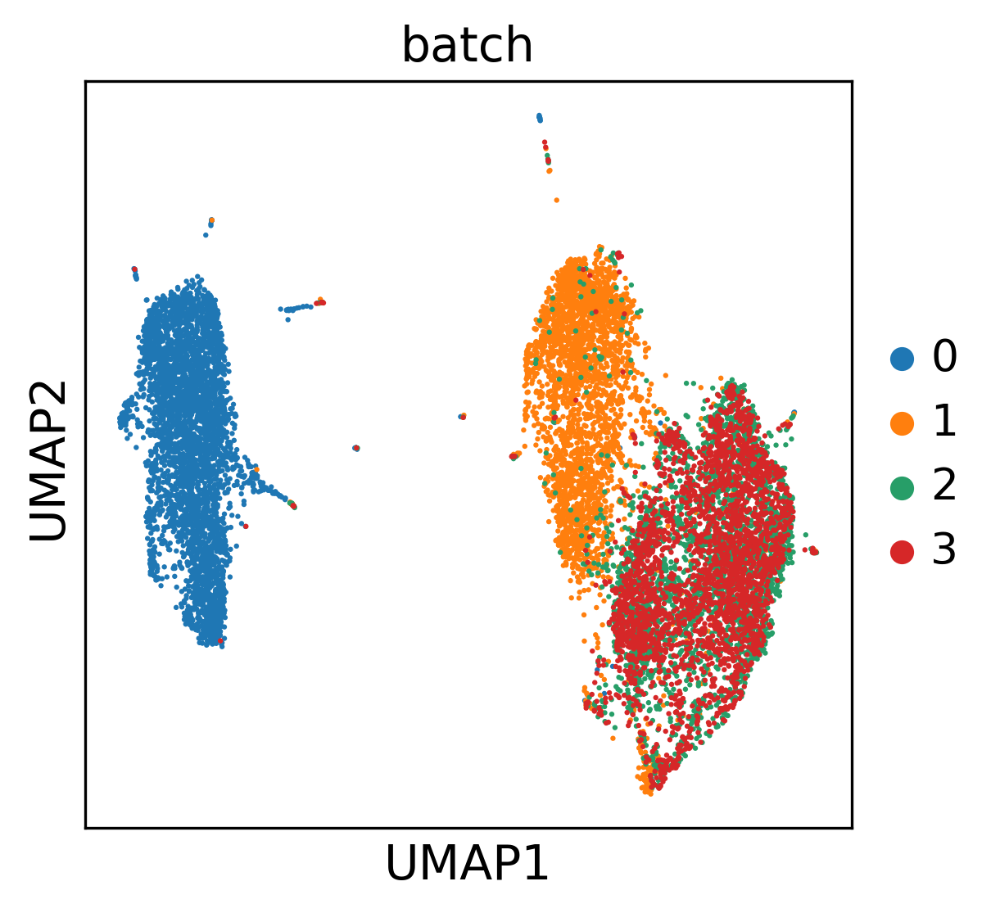

In [79]:
# Save clustering of the uncorrected batches
uncorrected_batch = sc.pl.umap(raw_umap,
                               color = "batch",
                               show = False)
uncorrected_batch.figure.savefig(h_stem + "_uncorrected.pdf",
                                 dpi = 300,
                                 transparent = True,
                                 bbox_inches = "tight")

In [80]:
# Save the projection to the original raw data structure
raw_h.obsm = raw_umap.obsm
# Save the raw data
raw_h.write(raw_h_file)

In [81]:
%%time
# Normalize and logarithmize data before batch correction
sc.pp.normalize_per_cell(raw_h)
sc.pp.log1p(raw_h)
# Perform batch correction using mutual nearest neighbors (Haghverdi et al. 2018)
correction = sc.pp.mnn_correct(*[raw_h[raw_h.obs["batch"] == batch, :] for batch in batch_names],
                               var_subset = raw_h[:, filter_result.gene_subset].var_names,
                               var_adj = True,
                               save_raw = True,
                               sigma = 0.1, # Default in R package scran; 1.0 in mnnpy
                               index_unique = None, # index_unique = None because we have prefiltered with barcode_files
                               n_jobs = 16)

Performing cosine normalization...
Starting MNN correct iteration. Reference batch: 0
Step 1 of 3: processing batch 1
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 2 of 3: processing batch 2
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 3 of 3: processing batch 3
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
MNN correction complete. Gathering output...
Packing AnnData object...
Done.
CPU times: user 21min 3s, sys: 23.6 s, total: 21min 27s
Wall time: 2min 29s


computing neighbors
    finished (0:00:42.80) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:00:15.18) --> added
    'X_umap', UMAP coordinates (adata.obsm)
CPU times: user 1min 16s, sys: 2.9 s, total: 1min 19s
Wall time: 1min


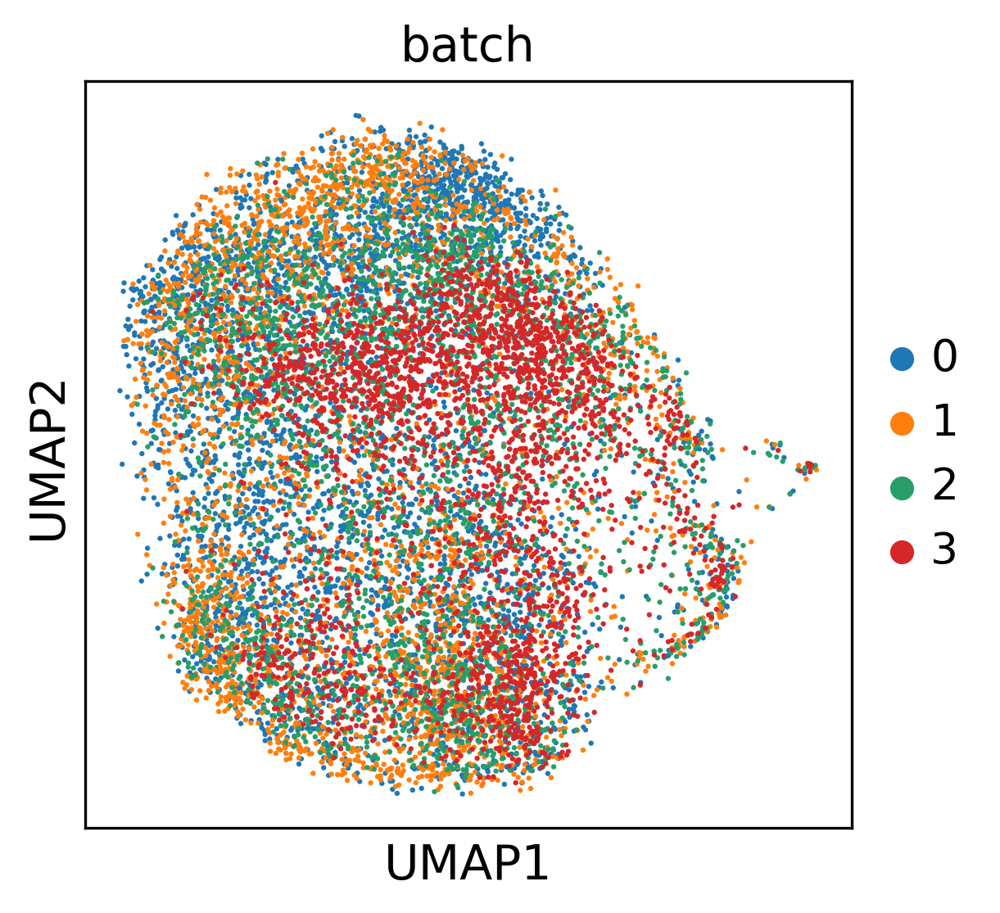

In [82]:
%%time
h_data = correction[0]
# # Project the new, batch corrected data
h_umap = h_data[:, filter_result.gene_subset]
# sc.pp.scale(corr_umap) Not scaling the corrected data yields better, more meaningful clustering
sc.pp.neighbors(h_umap,
                use_rep = 'X',
                n_neighbors = 15) # Default: 15
sc.tl.umap(h_umap, min_dist = 0.1)
# Plot and save the batch corrected clustring
corrected_batch = sc.pl.umap(h_umap,
                             color = "batch",
                             show = False)
corrected_batch.figure.savefig(h_stem + "_corrected.pdf",
                               dpi = 300,
                               transparent = True,
                               bbox_inches = "tight")

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:01.48) --> found 5 clusters and added
    'louvain', the cluster labels (adata.obs, categorical)


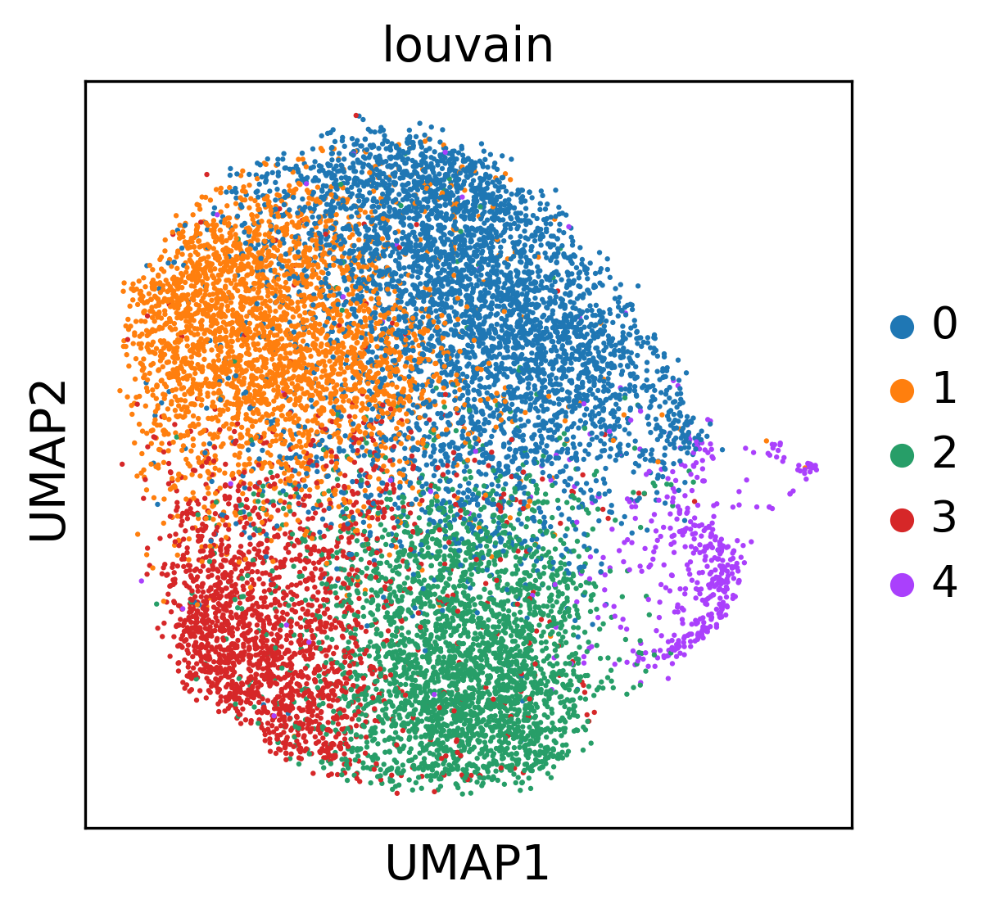

Memory usage: current 11.88 GB, difference +0.00 GB
CPU times: user 4.76 s, sys: 304 ms, total: 5.07 s
Wall time: 2.4 s


In [83]:
%%time
# Find clusters (lower resolution results in fewer clusters)
# Needs to happen on the re-projection subset
sc.tl.louvain(h_umap, resolution = 1)
sc.pl.umap(h_umap, color = ["louvain"])
sc.logging.print_memory_usage()

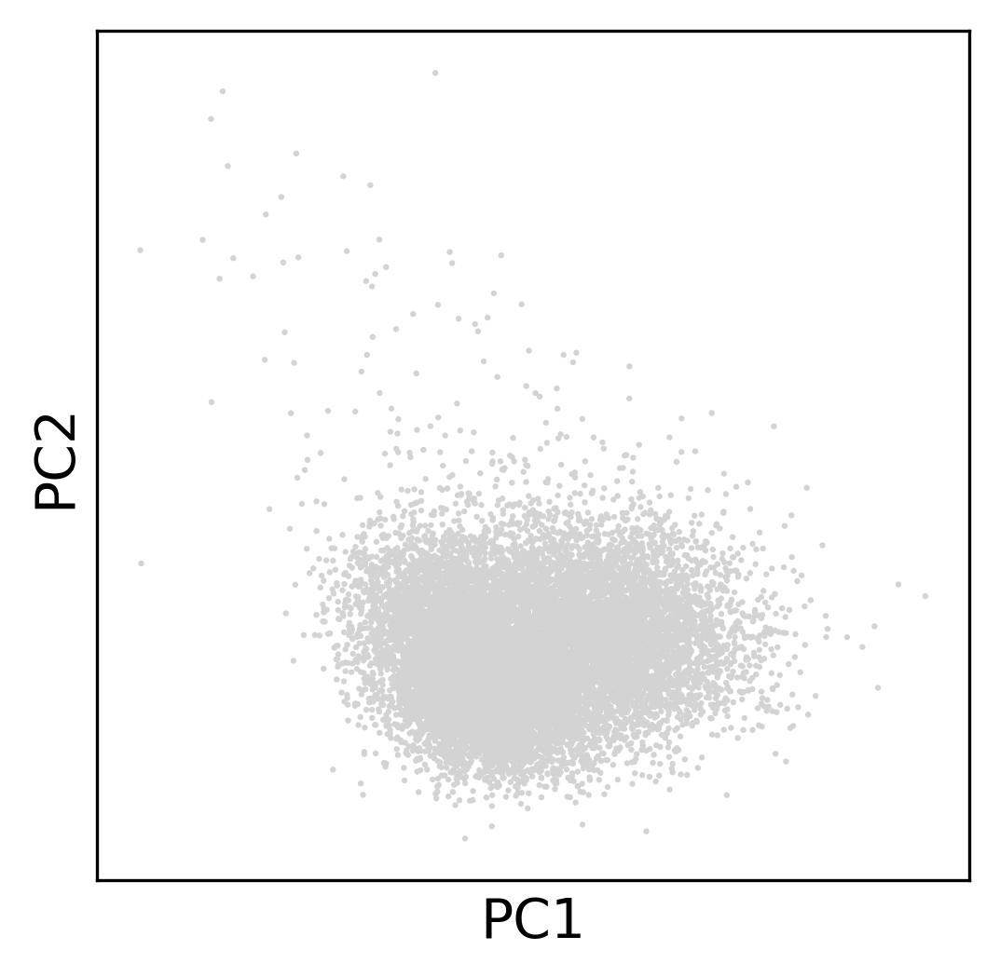

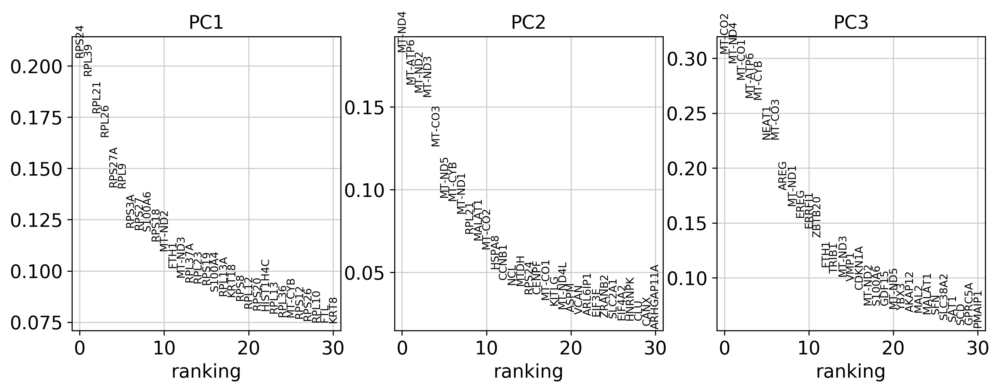

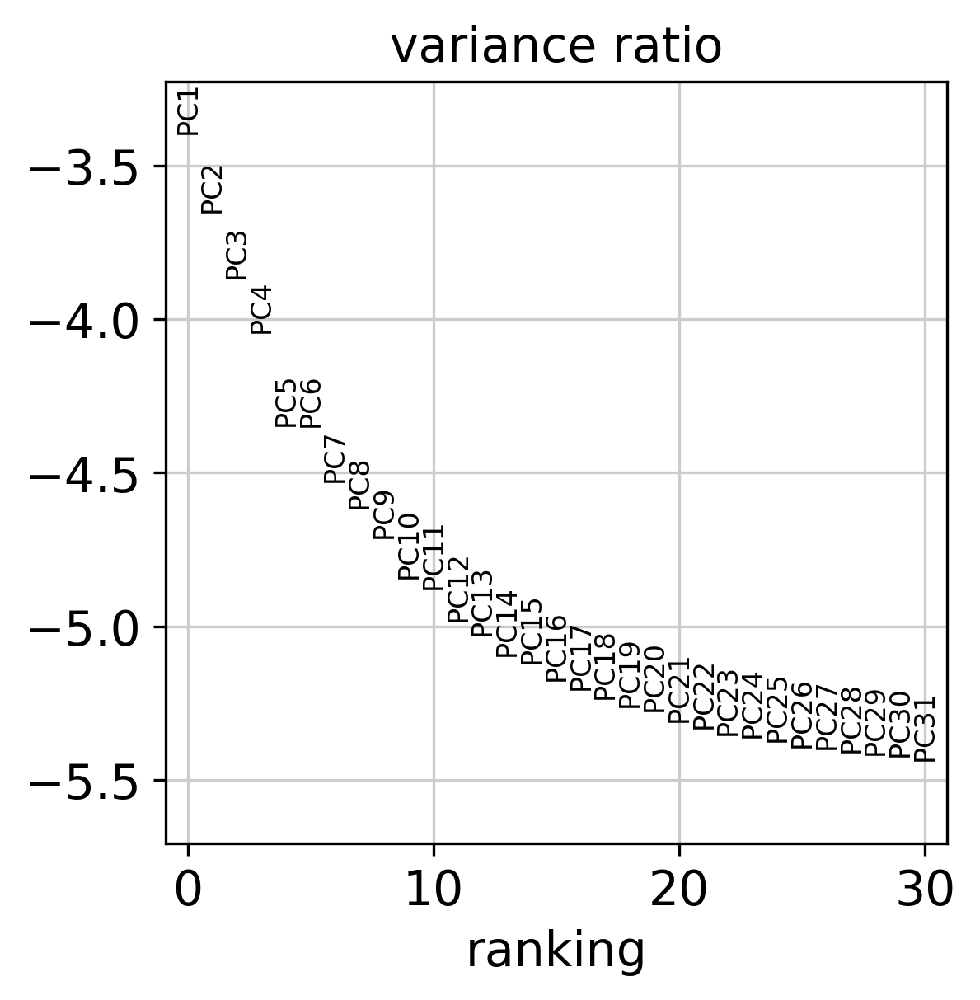

In [84]:
# Calculate PCAs on the batch-corrected dataset
sc.tl.pca(h_umap, svd_solver = "arpack")
sc.pl.pca(h_umap)
sc.pl.pca_loadings(h_umap)
sc.pl.pca_variance_ratio(h_umap, log = True)

In [85]:
# Save the new projection to the larger dataset
h_data.obsm = h_umap.obsm
h_data.uns = h_umap.uns
# h_data.varm = h_umap.varm
h_data.obs["louvain"] = h_umap.obs["louvain"]
# Save files to disk
h_data.write(h_file)
h_umap.write(umap_h_file)
raw_h.write(raw_h_file)

In [86]:
# Save as .loom
scanpyToLoom(h_data, h_stem + ".loom", "HCT-116_HyPBase_scRNA")

Wrote ../output_and_analysis/reanalysis/HCT-116-HyPB.loom
